In [3]:
try:
  %tensorflow_version 2.x
except Exception:
  pass
import tensorflow as tf
print(tf.__version__)

2.11.0


In [4]:
import string
from numpy import array
from pickle import load
from keras.preprocessing.text import Tokenizer
import matplotlib.pyplot as plt
from tensorflow.compat.v1.keras.backend import set_session
import keras
import sys, time, os, warnings 
warnings.filterwarnings("ignore")
import re
from tensorflow.keras.preprocessing.sequence import pad_sequences
import numpy as np
import pandas as pd 
from PIL import Image
import pickle
from collections import Counter
from keras.utils import to_categorical
from keras.utils import plot_model
from keras.models import Model
from keras.layers import Input
from keras.layers import Dense, BatchNormalization
from keras.layers import LSTM
from keras.layers import Embedding
from keras.layers import Dropout
from tensorflow.keras.layers import add
from keras.callbacks import ModelCheckpoint
from tensorflow.keras.preprocessing.image import load_img, img_to_array
from sklearn.utils import shuffle
from keras.applications.vgg16 import VGG16, preprocess_input
from sklearn.model_selection import train_test_split
from sklearn.utils import shuffle

# load and clean data

In [5]:
# load doc into memory
def load_doc(filename):
	# open the file as read only
	file = open(filename, 'r')
	# read all text
	text = file.read()
	# close the file
	file.close()
	return text

# To remove punctuations
def remove_punctuation(text_original):
    text_no_punctuation = text_original.translate(string.punctuation)
    return(text_no_punctuation)


# To remove single characters
def remove_single_character(text):
    text_len_more_than1 = ""
    for word in text.split():
        if len(word) > 1:
            text_len_more_than1 += " " + word
    return(text_len_more_than1)

# To remove numeric values
def remove_numeric(text,printTF=False):
    text_no_numeric = ""
    for word in text.split():
        isalpha = word.isalpha()
        if printTF:
            print("    {:10} : {:}".format(word,isalpha))
        if isalpha:
            text_no_numeric += " " + word
    return(text_no_numeric)

# Exploratory Data Analysis(EDA)

In [6]:
from os import listdir
## The location of the Flickr8K_ photos
image_dir = 'C:/Users/Vipul gaikwad/Desktop/College/Sem 6/Image-Captioning-using-Attention-Mechanism-Local-Attention-and-Global-Attention--master/dataset/Flicker8k_Dataset'
images = listdir(image_dir)

## The location of the caption file
descriptions_dir = 'C:/Users/Vipul gaikwad/Desktop/College/Sem 6/Image-Captioning-using-Attention-Mechanism-Local-Attention-and-Global-Attention--master/dataset/Flickr8k.token.txt'
print("The number of jpg flies in Flicker8k: {}".format(len(images)))

The number of jpg flies in Flicker8k: 16183


In [7]:
## read in the Flickr caption data
text = load_doc(descriptions_dir)
print(text[:325])

1000268201_693b08cb0e.jpg#0	A child in a pink dress is climbing up a set of stairs in an entry way .
1000268201_693b08cb0e.jpg#1	A girl going into a wooden building .
1000268201_693b08cb0e.jpg#2	A little girl climbing into a wooden playhouse .
1000268201_693b08cb0e.jpg#3	A little girl climbing the stairs to her playhouse .



# Creating of dataframe 


In [8]:
def make_dataset(text):
  df = []
  for sentences in text.split('\n'):
      splitted = sentences.split('\t')
      if len(splitted) == 1:
          continue
      w = splitted[0].split("#")
      df.append(w + [splitted[1].lower()])
  return df

In [9]:
df = make_dataset(text)

In [10]:
df[:10]

[['1000268201_693b08cb0e.jpg',
  '0',
  'a child in a pink dress is climbing up a set of stairs in an entry way .'],
 ['1000268201_693b08cb0e.jpg', '1', 'a girl going into a wooden building .'],
 ['1000268201_693b08cb0e.jpg',
  '2',
  'a little girl climbing into a wooden playhouse .'],
 ['1000268201_693b08cb0e.jpg',
  '3',
  'a little girl climbing the stairs to her playhouse .'],
 ['1000268201_693b08cb0e.jpg',
  '4',
  'a little girl in a pink dress going into a wooden cabin .'],
 ['1001773457_577c3a7d70.jpg',
  '0',
  'a black dog and a spotted dog are fighting'],
 ['1001773457_577c3a7d70.jpg',
  '1',
  'a black dog and a tri-colored dog playing with each other on the road .'],
 ['1001773457_577c3a7d70.jpg',
  '2',
  'a black dog and a white dog with brown spots are staring at each other in the street .'],
 ['1001773457_577c3a7d70.jpg',
  '3',
  'two dogs of different breeds looking at each other on the road .'],
 ['1001773457_577c3a7d70.jpg',
  '4',
  'two dogs on pavement moving t

In [11]:
data = pd.DataFrame(df,columns=["filename","index","caption"])
# Reordering columns for better readability
data = data.reindex(columns =['index','filename','caption'])

In [12]:
data

,index,filename,caption
0,0,1000268201_693b08cb0e.jpg,a child in a pink dress is climbing up a set o...
1,1,1000268201_693b08cb0e.jpg,a girl going into a wooden building .
2,2,1000268201_693b08cb0e.jpg,a little girl climbing into a wooden playhouse .
3,3,1000268201_693b08cb0e.jpg,a little girl climbing the stairs to her playh...
4,4,1000268201_693b08cb0e.jpg,a little girl in a pink dress going into a woo...
...,...,...,...
40455,0,997722733_0cb5439472.jpg,a man in a pink shirt climbs a rock face
40456,1,997722733_0cb5439472.jpg,a man is rock climbing high in the air .
40457,2,997722733_0cb5439472.jpg,a person in a red shirt climbing up a rock fac...
40458,3,997722733_0cb5439472.jpg,a rock climber in a red shirt .


# Some Data cleaning :
- All the filenames should end with __'.jpg'__ extension

In [13]:
# If any filename dosn't have .jpg extension at last then mark it as Invalid filename
def invalid_filename_check(data):
  for filenames in data["filename"]:
    found = re.search("(.(jpg)$)", filenames)
    if (found):
        pass
    else:
        print("Error file: {}".format(filenames))

In [14]:
invalid_filename_check(data)

Error file: 2258277193_586949ec62.jpg.1
Error file: 2258277193_586949ec62.jpg.1
Error file: 2258277193_586949ec62.jpg.1
Error file: 2258277193_586949ec62.jpg.1
Error file: 2258277193_586949ec62.jpg.1


- We must remove this error file from out dataset

In [15]:
data[data['filename'] == "2258277193_586949ec62.jpg.1"]

,index,filename,caption
6730,0,2258277193_586949ec62.jpg.1,people waiting for the subway
6731,1,2258277193_586949ec62.jpg.1,some people looking out windows in a large bui...
6732,2,2258277193_586949ec62.jpg.1,three people are waiting on a train platform .
6733,3,2258277193_586949ec62.jpg.1,three people standing at a station .
6734,4,2258277193_586949ec62.jpg.1,two woman and one man standing near train trac...


In [16]:
data = data[data['filename'] != '2258277193_586949ec62.jpg.1']
data.shape

(40455, 3)

# Checking dataframe

In [17]:
def utility_counter(data):

  unique_filenames = np.unique(data.filename.values)
  print("The number of unique file names : {}".format(len(unique_filenames)))

  ct_dict = Counter(data.filename.values)
  print("We can see that all the keys are having values count = 5")
  print(ct_dict)

  print("The distribution of the number of captions for each image:")
  ct = Counter(Counter(data.filename.values).values())
  print(ct)
  return unique_filenames

In [18]:
unique_filenames = utility_counter(data)

The number of unique file names : 8091
We can see that all the keys are having values count = 5
Counter({'1000268201_693b08cb0e.jpg': 5, '1001773457_577c3a7d70.jpg': 5, '1002674143_1b742ab4b8.jpg': 5, '1003163366_44323f5815.jpg': 5, '1007129816_e794419615.jpg': 5, '1007320043_627395c3d8.jpg': 5, '1009434119_febe49276a.jpg': 5, '1012212859_01547e3f17.jpg': 5, '1015118661_980735411b.jpg': 5, '1015584366_dfcec3c85a.jpg': 5, '101654506_8eb26cfb60.jpg': 5, '101669240_b2d3e7f17b.jpg': 5, '1016887272_03199f49c4.jpg': 5, '1019077836_6fc9b15408.jpg': 5, '1019604187_d087bf9a5f.jpg': 5, '1020651753_06077ec457.jpg': 5, '1022454332_6af2c1449a.jpg': 5, '1022454428_b6b660a67b.jpg': 5, '1022975728_75515238d8.jpg': 5, '102351840_323e3de834.jpg': 5, '1024138940_f1fefbdce1.jpg': 5, '102455176_5f8ead62d5.jpg': 5, '1026685415_0431cbf574.jpg': 5, '1028205764_7e8df9a2ea.jpg': 5, '1030985833_b0902ea560.jpg': 5, '103106960_e8a41d64f8.jpg': 5, '103195344_5d2dc613a3.jpg': 5, '103205630_682ca7285b.jpg': 5, '10321

#  Images along with there respective captions


In [22]:
import matplotlib.pyplot as plt


def image_desc_plotter(data):
    npic = 5
    npix = 224
    target_size = (npix, npix, 3)

    unique_filenames = data["filename"].unique()

    fig, axes = plt.subplots(2*npic, 1, figsize=(10, 30))
    for idx, jpgfnm in enumerate(unique_filenames[20:20+npic]):
        filename = image_dir + '/' + jpgfnm
        captions = list(data["caption"].loc[data["filename"] == jpgfnm].values)
        image_load = load_img(filename, target_size=target_size)

        # Plot image
        ax = axes[2*idx]
        ax.imshow(image_load)
        ax.set_title("Image " + str(idx+1))
        ax.axis('off')

        # Plot captions
        ax = axes[2*idx + 1]
        ax.set_xlim(0, 1)
        ax.set_ylim(0, len(captions))
        ax.axis('off')
        ax.set_title("Captions for Image " + str(idx+1))
        for i, caption in enumerate(captions):
            ax.text(0, i, caption, fontsize=12)

    plt.tight_layout()
    plt.show()

# Example usage
# image_desc_plotter(data)


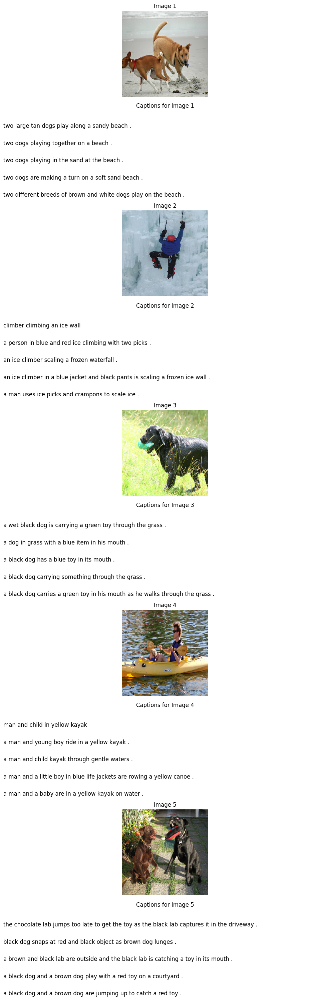

In [23]:
image_desc_plotter(data)

#  [3] Preprocessing




In [24]:
def create_vocabulary(data):
  vocab = []
  for captions in data.caption.values:
    vocab.extend(captions.split())
  print("Vocabulary Size : {}".format(len(set(vocab))))
  return vocab

In [25]:
vocabulary = create_vocabulary(data)

Vocabulary Size : 8918


### [3.2] Captions

In [26]:
def df_word_count(data,vocabulary):
    ct = Counter(vocabulary)
    appen_1 = []
    appen_2 = []
    for i in ct.keys():
        appen_1.append(i)
    for j in ct.values():
        appen_2.append(j)
    data = {"word":appen_1 , "count":appen_2}
    dfword = pd.DataFrame(data)
    dfword = dfword.sort_values(by='count', ascending=False)
    dfword = dfword.reset_index()[["word","count"]]
    return(dfword)

In [27]:
dfwordcount = df_word_count(data,vocabulary)

In [28]:
dfwordcount.iloc[:10,:]

,word,count
0,a,62986
1,.,36577
2,in,18974
3,the,18418
4,on,10743
5,is,9345
6,and,8851
7,dog,8136
8,with,7765
9,man,7265


## most and least frequently appearing words


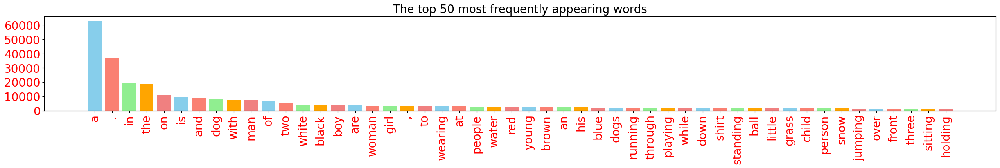

In [34]:

topn = 50

def plthist(dfsub, title="The top 50 most frequently appearing words"):
    plt.figure(figsize=(30, 3))
    # Specify different colors for the bars
    bar_colors = ['skyblue', 'salmon', 'lightgreen', 'orange', 'lightcoral']
    plt.bar(dfsub.index, dfsub["count"], color=bar_colors)
    plt.yticks(fontsize=20, color='r')
    plt.xticks(dfsub.index, dfsub["word"], rotation=90, fontsize=20, color='r')
    plt.title(title, fontsize=20)
    plt.show()

plthist(dfwordcount.iloc[:topn,:],
        title="The top 50 most frequently appearing words")


## Cleaning the captions
- The most common words are articles such as "a", or "the", or punctuations.

- These words do not have much infomation about the data.

- Using the utility functions (define in above cells) to clean the captions and restoring the cleaned captions to the dataset

In [35]:
def text_clean(text_original):
    text = remove_punctuation(text_original)
    text = remove_single_character(text)
    text = remove_numeric(text)
    return(text)
    
for i, caption in enumerate(data.caption.values):
    newcaption = text_clean(caption)
    data["caption"].iloc[i] = newcaption

In [36]:
clean_vocabulary = create_vocabulary(data)

Vocabulary Size : 8357


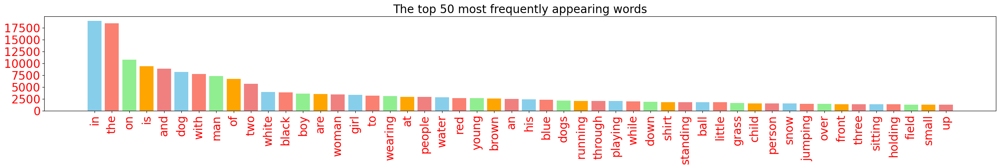

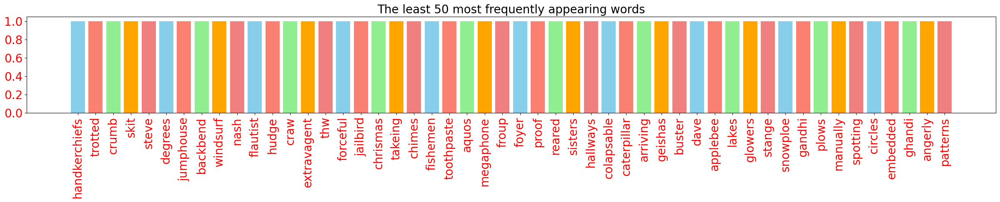

In [37]:
dfwordcount = df_word_count(data,clean_vocabulary)
plthist(dfwordcount.iloc[:topn,:],
        title="The top 50 most frequently appearing words")
plthist(dfwordcount.iloc[-topn:,:],
        title="The least 50 most frequently appearing words")

## Preprocessing the images
- Here we are setting the path for each image so that we can load the images at once using the path set

In [38]:
def preprocess_images(data):
  all_img_name_vector = []

  for filenames in data["filename"]:
      full_image_path = image_dir+"/"+ filenames
      all_img_name_vector.append(full_image_path)
  return all_img_name_vector
all_img_name_vector = preprocess_images(data)
all_img_name_vector[:10]

['C:/Users/Vipul gaikwad/Desktop/College/Sem 6/Image-Captioning-using-Attention-Mechanism-Local-Attention-and-Global-Attention--master/dataset/Flicker8k_Dataset/1000268201_693b08cb0e.jpg',
 'C:/Users/Vipul gaikwad/Desktop/College/Sem 6/Image-Captioning-using-Attention-Mechanism-Local-Attention-and-Global-Attention--master/dataset/Flicker8k_Dataset/1000268201_693b08cb0e.jpg',
 'C:/Users/Vipul gaikwad/Desktop/College/Sem 6/Image-Captioning-using-Attention-Mechanism-Local-Attention-and-Global-Attention--master/dataset/Flicker8k_Dataset/1000268201_693b08cb0e.jpg',
 'C:/Users/Vipul gaikwad/Desktop/College/Sem 6/Image-Captioning-using-Attention-Mechanism-Local-Attention-and-Global-Attention--master/dataset/Flicker8k_Dataset/1000268201_693b08cb0e.jpg',
 'C:/Users/Vipul gaikwad/Desktop/College/Sem 6/Image-Captioning-using-Attention-Mechanism-Local-Attention-and-Global-Attention--master/dataset/Flicker8k_Dataset/1000268201_693b08cb0e.jpg',
 'C:/Users/Vipul gaikwad/Desktop/College/Sem 6/Image-Ca

## adding '< start >' and '< end >' tags to every caption . To understand the model the start and end of the caption.

In [39]:
def preprocess_captions(data):
  total_captions = []

  for caption  in data["caption"].astype(str):
      caption = '<start> ' + caption+ ' <end>'
      total_captions.append(caption)
  return total_captions
total_captions = preprocess_captions(data)
total_captions[:10]

['<start>  child in pink dress is climbing up set of stairs in an entry way <end>',
 '<start>  girl going into wooden building <end>',
 '<start>  little girl climbing into wooden playhouse <end>',
 '<start>  little girl climbing the stairs to her playhouse <end>',
 '<start>  little girl in pink dress going into wooden cabin <end>',
 '<start>  black dog and spotted dog are fighting <end>',
 '<start>  black dog and dog playing with each other on the road <end>',
 '<start>  black dog and white dog with brown spots are staring at each other in the street <end>',
 '<start>  two dogs of different breeds looking at each other on the road <end>',
 '<start>  two dogs on pavement moving toward each other <end>']

## Let's view few image examples

In [40]:
ten_images = all_img_name_vector[:50] # Each image repeats 5 times in dataset
unique_images = np.unique(ten_images)
print(unique_images)

['C:/Users/Vipul gaikwad/Desktop/College/Sem 6/Image-Captioning-using-Attention-Mechanism-Local-Attention-and-Global-Attention--master/dataset/Flicker8k_Dataset/1000268201_693b08cb0e.jpg'
 'C:/Users/Vipul gaikwad/Desktop/College/Sem 6/Image-Captioning-using-Attention-Mechanism-Local-Attention-and-Global-Attention--master/dataset/Flicker8k_Dataset/1001773457_577c3a7d70.jpg'
 'C:/Users/Vipul gaikwad/Desktop/College/Sem 6/Image-Captioning-using-Attention-Mechanism-Local-Attention-and-Global-Attention--master/dataset/Flicker8k_Dataset/1002674143_1b742ab4b8.jpg'
 'C:/Users/Vipul gaikwad/Desktop/College/Sem 6/Image-Captioning-using-Attention-Mechanism-Local-Attention-and-Global-Attention--master/dataset/Flicker8k_Dataset/1003163366_44323f5815.jpg'
 'C:/Users/Vipul gaikwad/Desktop/College/Sem 6/Image-Captioning-using-Attention-Mechanism-Local-Attention-and-Global-Attention--master/dataset/Flicker8k_Dataset/1007129816_e794419615.jpg'
 'C:/Users/Vipul gaikwad/Desktop/College/Sem 6/Image-Caption

In [45]:
from matplotlib.pyplot import figure, imshow, axis
from matplotlib.image import imread

import math

def showImagesGrid(images, figsize=(10, 10), cmap='Greys_r'):
    """
    Display images in a grid layout.

    Parameters:
        - images: List of image paths or image arrays.
        - figsize: Tuple specifying the figure size.
        - cmap: Colormap for displaying grayscale images.

    """
    num_images = len(images)
    rows = math.ceil(math.sqrt(num_images))
    cols = math.ceil(num_images / rows)

    fig, axes = figure(figsize=figsize), []
    for i, image_path in enumerate(images):
        ax = fig.add_subplot(rows, cols, i + 1)
        if isinstance(image_path, str):
            image = imread(image_path)
        else:
            image = image_path
        axes.append(ax)
        ax.imshow(image, cmap=cmap)
        ax.set_xticks([])
        ax.set_yticks([])

    for ax in axes:
        ax.axis('off')

    fig.tight_layout()

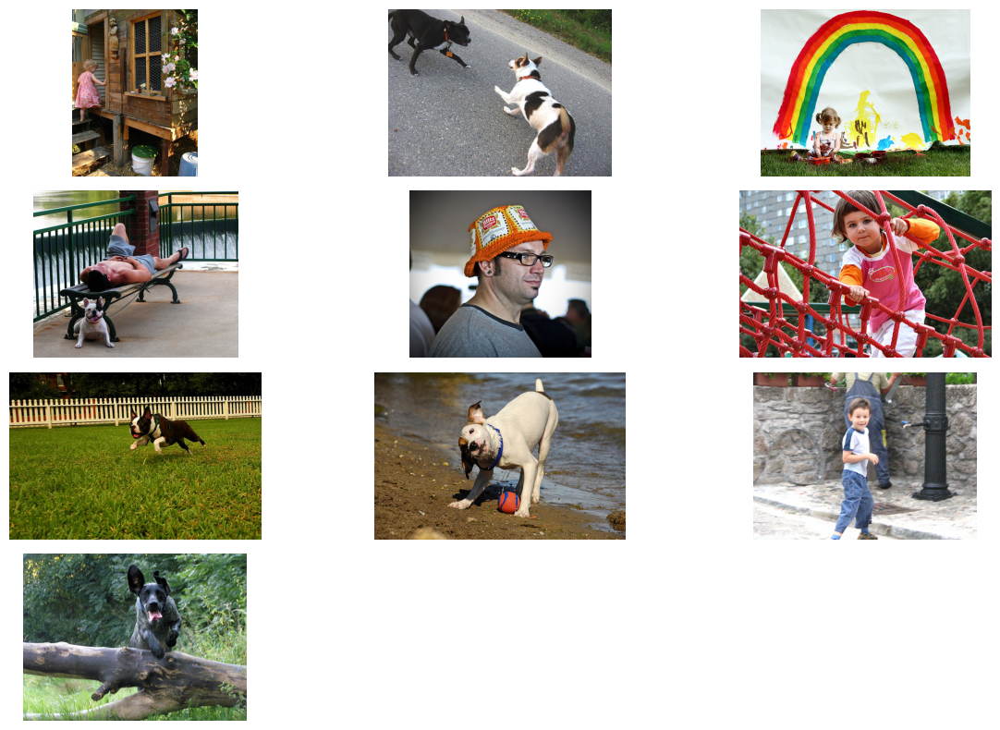

In [46]:
showImagesGrid(unique_images,figsize=(12, 8), cmap='Greys_r')

In [47]:
print("Total Images : " + str(len(all_img_name_vector)))
print("Total Captions : " + str(len(total_captions)))

Total Images : 40455
Total Captions : 40455


## Taking only 40,000 images and captions
- So that we can select batch size properly i.e. 625 batches if batch_size=64

In [48]:
def data_limiter(num,total_captions,all_img_name_vector):
  # Shuffle captions and image_names together
  train_captions, img_name_vector = shuffle(total_captions,all_img_name_vector,random_state=1)
  train_captions = train_captions[:num]
  img_name_vector = img_name_vector[:num]
  return train_captions,img_name_vector

In [49]:
train_captions,img_name_vector = data_limiter(40000,total_captions,all_img_name_vector)

In [50]:
print("Total Captions = {0} , Total images = {1}".format(len(train_captions),len(img_name_vector)))

Total Captions = 40000 , Total images = 40000


## Save variables in a pickle file and restore them to use it again

In [51]:
from pickle import dump

# save to file
dump(train_captions, open('captions.pkl', 'wb'))
dump(img_name_vector, open('img_names.pkl', 'wb'))

In [52]:
train_captions = load(open('captions.pkl', 'rb'))
img_name_vector = load(open('img_names.pkl', 'rb'))

In [53]:
print("Total Captions = {0} , Total images = {1}".format(len(train_captions),len(img_name_vector)))

Total Captions = 40000 , Total images = 40000


## Let's see some image shapes

In [54]:
# To know the shape of images
def img_shape_finder(image):
  img= plt.imread(image)

  print("Shape of the image ==> {0} is ==> {1}".format(image.split('/')[1],img.shape))

In [55]:
img_list=[]
for i in range(20):
  img_list.append(img_name_vector[i])

In [56]:
for j in img_list:
  img_shape_finder(j)

Shape of the image ==> Users is ==> (500, 375, 3)
Shape of the image ==> Users is ==> (375, 500, 3)
Shape of the image ==> Users is ==> (375, 500, 3)
Shape of the image ==> Users is ==> (400, 500, 3)
Shape of the image ==> Users is ==> (274, 500, 3)
Shape of the image ==> Users is ==> (375, 500, 3)
Shape of the image ==> Users is ==> (334, 500, 3)
Shape of the image ==> Users is ==> (500, 354, 3)
Shape of the image ==> Users is ==> (500, 333, 3)
Shape of the image ==> Users is ==> (350, 500, 3)
Shape of the image ==> Users is ==> (375, 500, 3)
Shape of the image ==> Users is ==> (375, 500, 3)
Shape of the image ==> Users is ==> (322, 500, 3)
Shape of the image ==> Users is ==> (375, 500, 3)
Shape of the image ==> Users is ==> (500, 333, 3)
Shape of the image ==> Users is ==> (333, 500, 3)
Shape of the image ==> Users is ==> (228, 500, 3)
Shape of the image ==> Users is ==> (500, 333, 3)
Shape of the image ==> Users is ==> (375, 500, 3)
Shape of the image ==> Users is ==> (375, 500, 3)


## Need to bring every image of shape (224,224,3).

Shape of the image:(375, 500, 3)


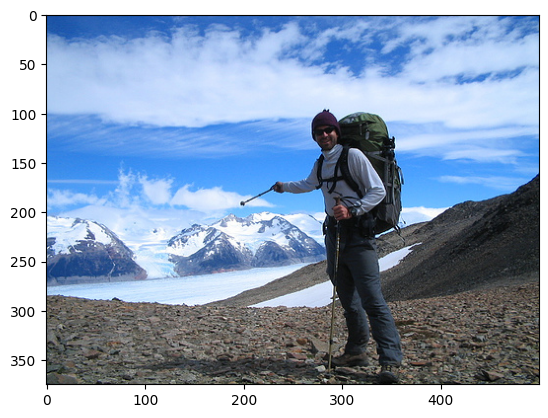

In [57]:
# To know the shape of images
def image_and_shapes(image):
  img= plt.imread(image)
  plt.imshow(img)
  print("Shape of the image:{}".format(img.shape))

image_and_shapes("C:/Users/Vipul gaikwad/Desktop/College/Sem 6/Image-Captioning-using-Attention-Mechanism-Local-Attention-and-Global-Attention--master/dataset/Flicker8k_Dataset/54501196_a9ac9d66f2.jpg")

## Creating functions and trying Image Augmentation

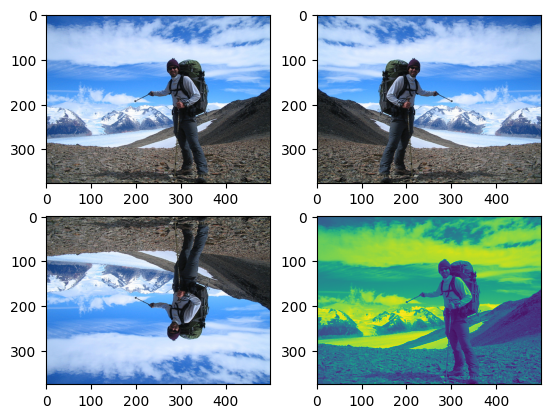

In [63]:
import imageio
def image_flipper(image):
  original_img = imageio.imread(image)
  
  plt.figure(1)

#Original Image

  plt.subplot(221)
  plt.imshow(original_img)

#Left-Right flip Image

  flipped_img_tensor = tf.image.flip_left_right(original_img)
  flipped_img= flipped_img_tensor.numpy()
  plt.subplot(222)
  plt.imshow(flipped_img)

#Up-Down flip Image

  upside_down_flip_tensor = tf.image.flip_up_down(original_img)
  upside_down_flip= upside_down_flip_tensor.numpy()
  plt.subplot(223)
  plt.imshow(upside_down_flip)

#Gray scale Image

  gray_tensor = tf.image.rgb_to_grayscale(original_img)
  grayimg= gray_tensor.numpy()
  plt.subplot(224)
  plt.imshow(tf.squeeze(grayimg))

  #plt.imsave('doggo.jpg',flipped_img)

image_flipper("C:/Users/Vipul gaikwad/Desktop/College/Sem 6/Image-Captioning-using-Attention-Mechanism-Local-Attention-and-Global-Attention--master/dataset/Flicker8k_Dataset/54501196_a9ac9d66f2.jpg")


## Resizing of images

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Shape after resize : (224, 224, 3)


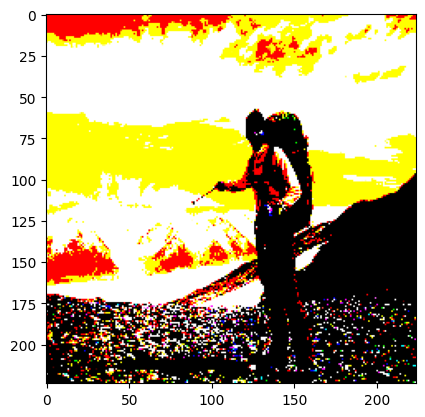

In [59]:
def load_image(image_path):
    img = tf.io.read_file(image_path)
    img = tf.image.decode_jpeg(img, channels=3)
    img = tf.image.resize(img, (224, 224))
    img = preprocess_input(img)
    return img, image_path

img1,img1_path = load_image("C:/Users/Vipul gaikwad/Desktop/College/Sem 6/Image-Captioning-using-Attention-Mechanism-Local-Attention-and-Global-Attention--master/dataset/Flicker8k_Dataset/54501196_a9ac9d66f2.jpg")
print("Shape after resize :", img1.shape)
plt.imshow(img1)

Shape of the image:(500, 375, 3)


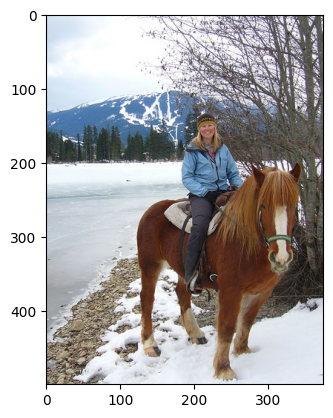

In [64]:
# To know the shape of images
def image_and_shapes(image):
  img= plt.imread(image)
  plt.imshow(img)
  print("Shape of the image:{}".format(img.shape))

image_and_shapes("C:/Users/Vipul gaikwad/Desktop/College/Sem 6/Image-Captioning-using-Attention-Mechanism-Local-Attention-and-Global-Attention--master/dataset/Flicker8k_Dataset/109202756_b97fcdc62c.jpg")

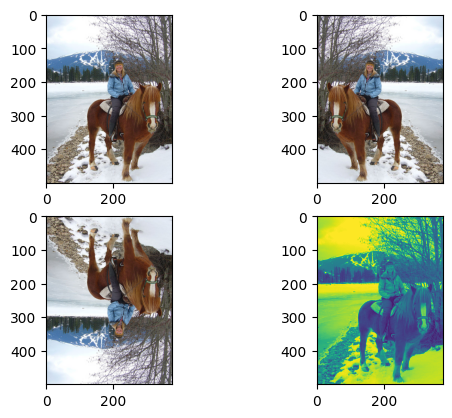

In [65]:
import imageio
def image_flipper(image):
  original_img = imageio.imread(image)
  
  plt.figure(1)

#Original Image

  plt.subplot(221)
  plt.imshow(original_img)

#Left-Right flip Image

  flipped_img_tensor = tf.image.flip_left_right(original_img)
  flipped_img= flipped_img_tensor.numpy()
  plt.subplot(222)
  plt.imshow(flipped_img)

#Up-Down flip Image

  upside_down_flip_tensor = tf.image.flip_up_down(original_img)
  upside_down_flip= upside_down_flip_tensor.numpy()
  plt.subplot(223)
  plt.imshow(upside_down_flip)

#Gray scale Image

  gray_tensor = tf.image.rgb_to_grayscale(original_img)
  grayimg= gray_tensor.numpy()
  plt.subplot(224)
  plt.imshow(tf.squeeze(grayimg))

  #plt.imsave('doggo.jpg',flipped_img)

image_flipper("C:/Users/Vipul gaikwad/Desktop/College/Sem 6/Image-Captioning-using-Attention-Mechanism-Local-Attention-and-Global-Attention--master/dataset/Flicker8k_Dataset/109202756_b97fcdc62c.jpg")


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Shape after resize : (224, 224, 3)


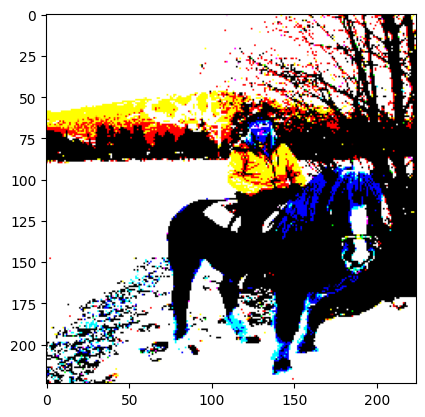

In [66]:
def load_image(image_path):
    img = tf.io.read_file(image_path)
    img = tf.image.decode_jpeg(img, channels=3)
    img = tf.image.resize(img, (224, 224))
    img = preprocess_input(img)
    return img, image_path

img1,img1_path = load_image("C:/Users/Vipul gaikwad/Desktop/College/Sem 6/Image-Captioning-using-Attention-Mechanism-Local-Attention-and-Global-Attention--master/dataset/Flicker8k_Dataset/109202756_b97fcdc62c.jpg")
print("Shape after resize :", img1.shape)
plt.imshow(img1)

## Image Histograms
- Histogram is considered as a graph or plot which is related to frequency of pixels in an Gray Scale Image
with pixel values (ranging from 0 to 255). Grayscale image is an image in which the value of each pixel is a single sample, that is, it carries only intensity information where pixel value varies from 0 to 255. 

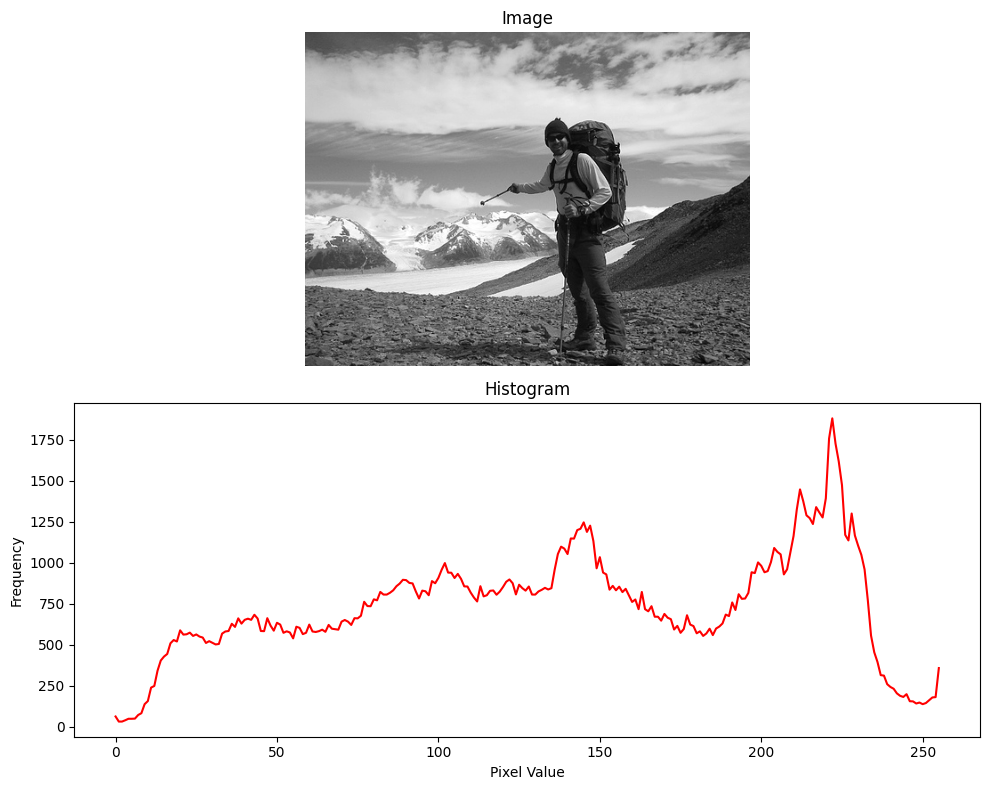

In [61]:
# importing required libraries of opencv 
import cv2 
# importing library for plotting 
from matplotlib import pyplot as plt 
def plot_image_histograms(image): 
    # reads an input image 
    img = cv2.imread(image, 0) 
    # find frequency of pixels in range 0-255 
    histr = cv2.calcHist([img], [0], None, [256], [0, 256]) 

    # Customizing plot colors
    fig, ax = plt.subplots(2, 1, figsize=(10, 8))
    
    # Plotting the image
    ax[0].imshow(img, cmap='gray')  # Display the image in grayscale
    ax[0].set_title('Image')
    ax[0].axis('off')

    # Plotting the histogram
    ax[1].plot(histr, color='red')  # Plot the histogram in red color
    ax[1].set_title('Histogram')
    ax[1].set_xlabel('Pixel Value')
    ax[1].set_ylabel('Frequency')

    plt.tight_layout()
    plt.show()

plot_image_histograms('C:/Users/Vipul gaikwad/Desktop/College/Sem 6/Image-Captioning-using-Attention-Mechanism-Local-Attention-and-Global-Attention--master/dataset/Flicker8k_Dataset/54501196_a9ac9d66f2.jpg')

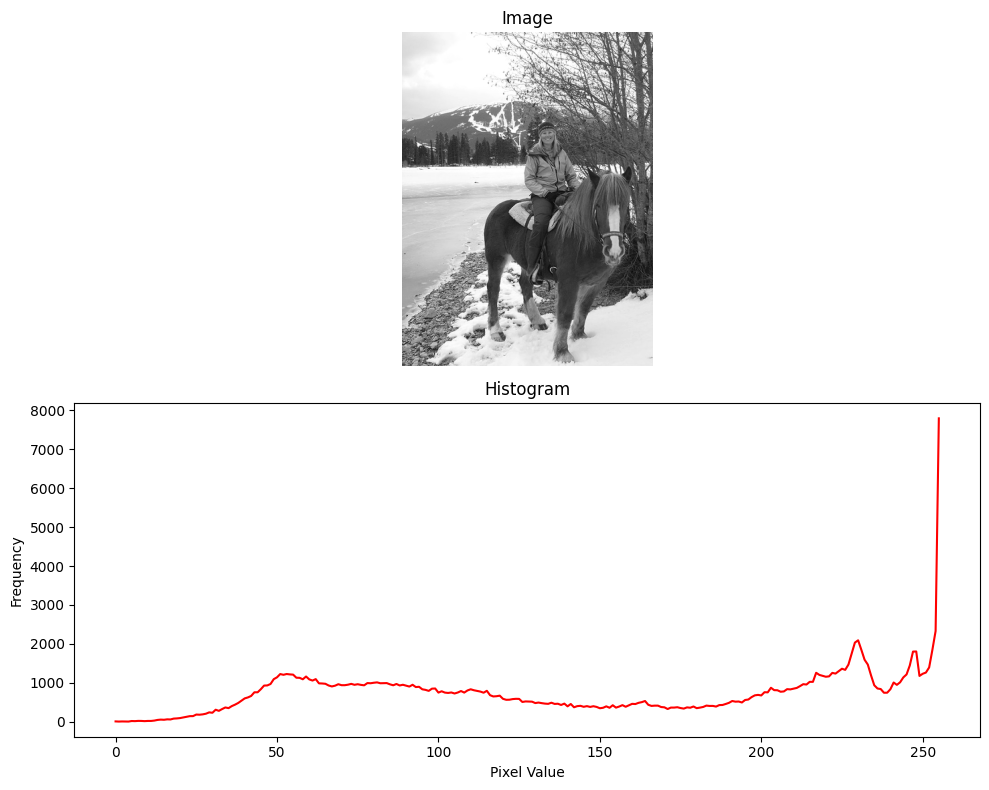

In [62]:
# importing required libraries of opencv 
import cv2 
# importing library for plotting 
from matplotlib import pyplot as plt 
def plot_image_histograms(image): 
    # reads an input image 
    img = cv2.imread(image, 0) 
    # find frequency of pixels in range 0-255 
    histr = cv2.calcHist([img], [0], None, [256], [0, 256]) 

    # Customizing plot colors
    fig, ax = plt.subplots(2, 1, figsize=(10, 8))
    
    # Plotting the image
    ax[0].imshow(img, cmap='gray')  # Display the image in grayscale
    ax[0].set_title('Image')
    ax[0].axis('off')

    # Plotting the histogram
    ax[1].plot(histr, color='red')  # Plot the histogram in red color
    ax[1].set_title('Histogram')
    ax[1].set_xlabel('Pixel Value')
    ax[1].set_ylabel('Frequency')

    plt.tight_layout()
    plt.show()

plot_image_histograms('C:/Users/Vipul gaikwad/Desktop/College/Sem 6/Image-Captioning-using-Attention-Mechanism-Local-Attention-and-Global-Attention--master/dataset/Flicker8k_Dataset/109202756_b97fcdc62c.jpg')

## Pre-Trained Image Model (VGG16)


In [67]:
import tensorflow as tf
modelvgg = tf.keras.applications.VGG16(include_top=True,weights=None) # for observation on shapes

In [68]:
modelvgg.summary()

Model: "vgg16"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_1 (InputLayer)        [(None, 224, 224, 3)]     0         
                                                                 
 block1_conv1 (Conv2D)       (None, 224, 224, 64)      1792      
                                                                 
 block1_conv2 (Conv2D)       (None, 224, 224, 64)      36928     
                                                                 
 block1_pool (MaxPooling2D)  (None, 112, 112, 64)      0         
                                                                 
 block2_conv1 (Conv2D)       (None, 112, 112, 128)     73856     
                                                                 
 block2_conv2 (Conv2D)       (None, 112, 112, 128)     147584    
                                                                 
 block2_pool (MaxPooling2D)  (None, 56, 56, 128)       0     

# VGG16 MODEL FOR FEATURE EXTRACTION

In [69]:
def create_vgg16_feature_extraction_model():
    image_model = tf.keras.applications.VGG16(include_top=False, weights='imagenet')
    new_input = image_model.input
    hidden_layer = image_model.layers[-1].output
    image_features_extract_model = tf.keras.Model(new_input, hidden_layer)
    return image_features_extract_model
  

# ResNET50 MODEL FOR FEATURE EXTRACTION

In [70]:
def create_ResNet50_feature_extraction_model():
    image_model = tf.keras.applications.ResNet50(include_top=False, weights='imagenet')
    new_input = image_model.input
    hidden_layer = image_model.layers[-1].output
    image_features_extract_model = tf.keras.Model(new_input, hidden_layer)
    return image_features_extract_model

# InceptionV3 MODEL FOR FEATURE EXTRACTION

In [71]:
def create_InceptionV3_feature_extraction_model():    
    image_model = tf.keras.applications.InceptionV3(include_top=False, weights='imagenet')
    new_input = image_model.input
    hidden_layer = image_model.layers[-1].output
    image_features_extract_model = tf.keras.Model(new_input, hidden_layer)
    return image_features_extract_model



In [72]:
encoder_choice = input("Choose the type of model you want to apply :")

Choose the type of model you want to apply :VGG16


In [74]:
if(encoder_choice=='VGG16'):
    image_features_extract_model = create_vgg16_feature_extraction_model()
elif(encoder_choice=='ResNet50'):
    image_features_extract_model = create_ResNet50_feature_extraction_model()  
else:
    image_features_extract_model = create_InceptionV3_feature_extraction_model()

In [75]:
image_features_extract_model.summary()

Model: "model"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_2 (InputLayer)        [(None, None, None, 3)]   0         
                                                                 
 block1_conv1 (Conv2D)       (None, None, None, 64)    1792      
                                                                 
 block1_conv2 (Conv2D)       (None, None, None, 64)    36928     
                                                                 
 block1_pool (MaxPooling2D)  (None, None, None, 64)    0         
                                                                 
 block2_conv1 (Conv2D)       (None, None, None, 128)   73856     
                                                                 
 block2_conv2 (Conv2D)       (None, None, None, 128)   147584    
                                                                 
 block2_pool (MaxPooling2D)  (None, None, None, 128)   0     

## Features extractraction from VGG16

 


In [65]:
# Get unique images
encode_train = sorted(set(img_name_vector))
print(encode_train[:10])

['C:/Users/Vipul gaikwad/Desktop/College/Sem 6/Image-Captioning-using-Attention-Mechanism-Local-Attention-and-Global-Attention--master/dataset/Flicker8k_Dataset/1000268201_693b08cb0e.jpg', 'C:/Users/Vipul gaikwad/Desktop/College/Sem 6/Image-Captioning-using-Attention-Mechanism-Local-Attention-and-Global-Attention--master/dataset/Flicker8k_Dataset/1001773457_577c3a7d70.jpg', 'C:/Users/Vipul gaikwad/Desktop/College/Sem 6/Image-Captioning-using-Attention-Mechanism-Local-Attention-and-Global-Attention--master/dataset/Flicker8k_Dataset/1002674143_1b742ab4b8.jpg', 'C:/Users/Vipul gaikwad/Desktop/College/Sem 6/Image-Captioning-using-Attention-Mechanism-Local-Attention-and-Global-Attention--master/dataset/Flicker8k_Dataset/1003163366_44323f5815.jpg', 'C:/Users/Vipul gaikwad/Desktop/College/Sem 6/Image-Captioning-using-Attention-Mechanism-Local-Attention-and-Global-Attention--master/dataset/Flicker8k_Dataset/1007129816_e794419615.jpg', 'C:/Users/Vipul gaikwad/Desktop/College/Sem 6/Image-Caption

In [66]:
image_dataset = tf.data.Dataset.from_tensor_slices(encode_train)
for files in image_dataset: 
    print(files.numpy())

b'C:/Users/Vipul gaikwad/Desktop/College/Sem 6/Image-Captioning-using-Attention-Mechanism-Local-Attention-and-Global-Attention--master/dataset/Flicker8k_Dataset/1000268201_693b08cb0e.jpg'
b'C:/Users/Vipul gaikwad/Desktop/College/Sem 6/Image-Captioning-using-Attention-Mechanism-Local-Attention-and-Global-Attention--master/dataset/Flicker8k_Dataset/1001773457_577c3a7d70.jpg'
b'C:/Users/Vipul gaikwad/Desktop/College/Sem 6/Image-Captioning-using-Attention-Mechanism-Local-Attention-and-Global-Attention--master/dataset/Flicker8k_Dataset/1002674143_1b742ab4b8.jpg'
b'C:/Users/Vipul gaikwad/Desktop/College/Sem 6/Image-Captioning-using-Attention-Mechanism-Local-Attention-and-Global-Attention--master/dataset/Flicker8k_Dataset/1003163366_44323f5815.jpg'
b'C:/Users/Vipul gaikwad/Desktop/College/Sem 6/Image-Captioning-using-Attention-Mechanism-Local-Attention-and-Global-Attention--master/dataset/Flicker8k_Dataset/1007129816_e794419615.jpg'
b'C:/Users/Vipul gaikwad/Desktop/College/Sem 6/Image-Caption

## Map each image name to the function to load the image 

In [67]:
# Feel free to change batch_size according to your system configuration
image_dataset = image_dataset.map(load_image, num_parallel_calls=tf.data.experimental.AUTOTUNE).batch(64)

## After this step all the images have been resized to (224,224,3)

In [68]:
image_dataset

<BatchDataset element_spec=(TensorSpec(shape=(None, 224, 224, 3), dtype=tf.float32, name=None), TensorSpec(shape=(None,), dtype=tf.string, name=None))>

In [69]:
from tqdm import tqdm

- An NPY file is a NumPy array file created by the Python software package with the NumPy library installed. It contains an array saved in the NumPy (NPY) file format. NPY files store all the information required to reconstruct an array on any computer, which includes dtype and shape information.

In [69]:
  for img, path in tqdm(image_dataset):
    batch_features = image_features_extract_model(img)
    batch_features = tf.reshape(batch_features,(batch_features.shape[0], -1, batch_features.shape[3]))
    for bf, p in zip(batch_features, path):
        path_of_feature = p.numpy().decode("utf-8")
        print("Saving to:", path_of_feature)
        np.save(path_of_feature, bf.numpy())

  1%|▋                                                                                 | 1/127 [00:14<29:47, 14.18s/it]

Saving to: C:/Users/Vipul gaikwad/Desktop/College/Sem 6/Image-Captioning-using-Attention-Mechanism-Local-Attention-and-Global-Attention--master/dataset/Flicker8k_Dataset/1000268201_693b08cb0e.jpg
Saving to: C:/Users/Vipul gaikwad/Desktop/College/Sem 6/Image-Captioning-using-Attention-Mechanism-Local-Attention-and-Global-Attention--master/dataset/Flicker8k_Dataset/1001773457_577c3a7d70.jpg
Saving to: C:/Users/Vipul gaikwad/Desktop/College/Sem 6/Image-Captioning-using-Attention-Mechanism-Local-Attention-and-Global-Attention--master/dataset/Flicker8k_Dataset/1002674143_1b742ab4b8.jpg
Saving to: C:/Users/Vipul gaikwad/Desktop/College/Sem 6/Image-Captioning-using-Attention-Mechanism-Local-Attention-and-Global-Attention--master/dataset/Flicker8k_Dataset/1003163366_44323f5815.jpg
Saving to: C:/Users/Vipul gaikwad/Desktop/College/Sem 6/Image-Captioning-using-Attention-Mechanism-Local-Attention-and-Global-Attention--master/dataset/Flicker8k_Dataset/1007129816_e794419615.jpg
Saving to: C:/Users/

  1%|▋                                                                                 | 1/127 [00:26<55:47, 26.57s/it]


KeyboardInterrupt: 

In [76]:
np_img =np.load('C:/Users/Vipul gaikwad/Desktop/College/Sem 6/Image-Captioning-using-Attention-Mechanism-Local-Attention-and-Global-Attention--master/dataset/Flicker8k_Dataset/3338291921_fe7ae0c8f8.jpg.npy')

In [78]:
print(np_img)
print("Shape : {}".format(np_img.shape))

[[0.        0.        0.        ... 0.        0.        0.       ]
 [0.        0.        0.        ... 0.        0.        0.       ]
 [0.        0.        0.        ... 0.        0.        0.       ]
 ...
 [0.        0.        0.        ... 0.        0.        0.       ]
 [0.        0.        0.        ... 0.        3.9950874 0.       ]
 [0.        0.        0.        ... 0.        0.        0.       ]]
Shape : (49, 512)


## Data Preparation for a Language Generation(RNN) DECODER
- We will perform a few basic pre-processing steps on the captions such as:
  1. First, we will tokenize the captions. This will help us to build a vocabulary of all the unique words in the data.
  2. Next, we will limit the vocabulary size to top 5000 words to save memory. We will replace all the other words with the token < unk > (for words not in vocabulary) . You , can obviously optimize that according to the use cases.
  3. Finally, we will create a word->index mapping and vice versa.
  4. We will pad all sequences to be the same length as the longest one. 

## Tokenizing the captions and creating vocabulary

In [79]:
def tokenize_caption(top_k,train_captions):
 
  tokenizer = tf.keras.preprocessing.text.Tokenizer(num_words=top_k,oov_token="<unk>",filters='!"#$%&()*+.,-/:;=?@[\]^_`{|}~ ')
 
  
  tokenizer.fit_on_texts(train_captions)
  train_seqs = tokenizer.texts_to_sequences(train_captions)

  # Map '<pad>' to '0'
  tokenizer.word_index['<pad>'] = 0
  tokenizer.index_word[0] = '<pad>'


  # Create the tokenized vectors
  train_seqs = tokenizer.texts_to_sequences(train_captions)
  return train_seqs, tokenizer

train_seqs , tokenizer = tokenize_caption(5000,train_captions)

In [80]:
train_captions[:3]

['<start>  several children leaping into pile of leaves on the ground <end>',
 '<start>  man hiking in the wilderness giving the camera thumbs up <end>',
 '<start>  white dog is running through the water onto the shore <end>']

In [81]:
train_seqs[:3] # Here we can see that the sentences are converted to sequences

[[2, 184, 62, 331, 64, 524, 12, 329, 6, 5, 167, 3],
 [2, 11, 588, 4, 5, 2384, 895, 5, 93, 1281, 53, 3],
 [2, 14, 9, 7, 32, 33, 5, 24, 238, 5, 280, 3]]

- Here we can see that the size of each caption vectors are different.
- So, we need to pad the vector upto max_length of the caption

In [82]:
# oov_token: if given, it will be added to word_index and used to replace out-of-vocabulary words during text_to_sequence calls
tokenizer.oov_token

'<unk>'

In [83]:
tokenizer.index_word

{1: '<unk>',
 2: '<start>',
 3: '<end>',
 4: 'in',
 5: 'the',
 6: 'on',
 7: 'is',
 8: 'and',
 9: 'dog',
 10: 'with',
 11: 'man',
 12: 'of',
 13: 'two',
 14: 'white',
 15: 'black',
 16: 'boy',
 17: 'are',
 18: 'woman',
 19: 'girl',
 20: 'to',
 21: 'wearing',
 22: 'at',
 23: 'people',
 24: 'water',
 25: 'red',
 26: 'young',
 27: 'brown',
 28: 'an',
 29: 'his',
 30: 'blue',
 31: 'dogs',
 32: 'running',
 33: 'through',
 34: 'playing',
 35: 'while',
 36: 'down',
 37: 'shirt',
 38: 'standing',
 39: 'ball',
 40: 'little',
 41: 'grass',
 42: 'child',
 43: 'person',
 44: 'snow',
 45: 'jumping',
 46: 'over',
 47: 'front',
 48: 'three',
 49: 'sitting',
 50: 'holding',
 51: 'field',
 52: 'small',
 53: 'up',
 54: 'by',
 55: 'large',
 56: 'green',
 57: 'one',
 58: 'group',
 59: 'yellow',
 60: 'her',
 61: 'walking',
 62: 'children',
 63: 'men',
 64: 'into',
 65: 'air',
 66: 'beach',
 67: 'near',
 68: 'mouth',
 69: 'jumps',
 70: 'another',
 71: 'for',
 72: 'street',
 73: 'its',
 74: 'runs',
 75: 'from

In [84]:
tokenizer.word_counts

OrderedDict([('<start>', 40000),
             ('several', 308),
             ('children', 1136),
             ('leaping', 138),
             ('into', 1067),
             ('pile', 74),
             ('of', 6632),
             ('leaves', 139),
             ('on', 10622),
             ('the', 18232),
             ('ground', 355),
             ('<end>', 40000),
             ('man', 7193),
             ('hiking', 63),
             ('in', 18771),
             ('wilderness', 6),
             ('giving', 34),
             ('camera', 685),
             ('thumbs', 19),
             ('up', 1244),
             ('white', 3896),
             ('dog', 8046),
             ('is', 9266),
             ('running', 2049),
             ('through', 2012),
             ('water', 2757),
             ('onto', 211),
             ('shore', 169),
             ('young', 2598),
             ('relaxing', 15),
             ('his', 2327),
             ('legs', 130),
             ('pice', 1),
             ('machinery', 1),

### MaxLength and MinLength of any captions

In [85]:
# Find the maximum length of any caption in our dataset
def calc_max_length(tensor):
    return max(len(t) for t in tensor)
# Calculates the max_length, which is used to store the attention weights
max_length = calc_max_length(train_seqs)

In [86]:
# Find the maximum length of any caption in our dataset
def calc_min_length(tensor):
    return min(len(t) for t in tensor)
# Calculates the max_length, which is used to store the attention weights
min_length = calc_min_length(train_seqs)

In [87]:
print('Max Length of any caption : Min Length of any caption = '+ str(max_length) +" : "+str(min_length))

Max Length of any caption : Min Length of any caption = 33 : 2


[Text(0.5, 0, 'Caption Length'),
 Text(0, 0.5, 'Frequency'),
 Text(0.5, 1.0, 'Distribution of Caption Lengths')]

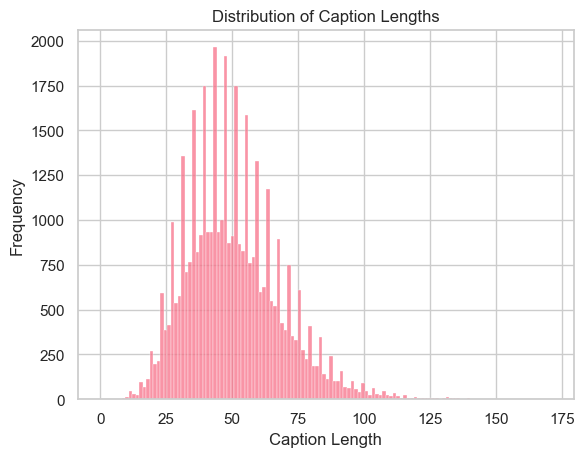

In [89]:
import seaborn as sns
import pandas as pd
import matplotlib.pyplot as plt

# Assuming 'data' is your existing DataFrame with a 'caption' column
# You might need to replace 'data' with your actual DataFrame

df = pd.DataFrame()
df["sequence_length"] = data["caption"].apply(len)

# Set the style and color palette
sns.set_style("whitegrid")
sns.set_palette("husl")

# Create the distribution plot
distribution = sns.histplot(df["sequence_length"], kde=False)  # Change from line plot to histogram

# Customizing labels and title
distribution.set(xlabel='Caption Length', ylabel='Frequency', title='Distribution of Caption Lengths')


## Pad each vector to the max_length of the captions, so that all caption vectors are of same length



In [90]:
def padding_train_sequences(train_seqs,max_length,padding_type):
  cap_vector = tf.keras.preprocessing.sequence.pad_sequences(train_seqs, padding=padding_type,maxlen=max_length)
  return cap_vector

In [91]:
padded_caption_vector = padding_train_sequences(train_seqs,max_length,'post')
print(padded_caption_vector.shape)

(40000, 33)


In [92]:
padded_caption_vector

array([[  2, 184,  62, ...,   0,   0,   0],
       [  2,  11, 588, ...,   0,   0,   0],
       [  2,  14,   9, ...,   0,   0,   0],
       ...,
       [  2,  19,   4, ...,   0,   0,   0],
       [  2,  16,   4, ...,   0,   0,   0],
       [  2, 153,   9, ...,   0,   0,   0]])

## Train-Test Split (80:20)

In [93]:
# Create training and test set using an 80-20 split
img_name_train, img_name_test, caption_train, caption_test = train_test_split(img_name_vector,padded_caption_vector,test_size=0.2,random_state=0)

In [94]:
print("Training Data : X = {0},Y = {1}".format(len(img_name_train), len(caption_train)))
print("Test Data : X = {0},Y = {1}".format(len(img_name_test), len(caption_test)))

Training Data : X = 32000,Y = 32000
Test Data : X = 8000,Y = 8000


## Creating dataset

### Loading the .npy files

In [95]:
BATCH_SIZE = 64
BUFFER_SIZE = 1000

In [96]:
def load_npy(img_name, cap):
  img_tensor = np.load(img_name.decode('utf-8')+'.npy')
  return img_tensor, cap

In [97]:
'''
# How Dataset.from_tensor_slices work
t = tf.constant([[1, 2], [3, 4]])
ds = tf.data.Dataset.from_tensor_slices(t)   # [1, 2], [3, 4]
ds # <TensorSliceDataset shapes: (2,), types: tf.int32>
'''
def create_dataset(img_name_train,caption_train):

  
  dataset = tf.data.Dataset.from_tensor_slices((img_name_train, caption_train))

  # Use map to load the numpy files in parallel
  dataset = dataset.map(lambda item1, item2: tf.numpy_function(load_npy, [item1, item2], [tf.float32, tf.int32]),num_parallel_calls=tf.data.experimental.AUTOTUNE)

  # Shuffle and batch
  dataset = dataset.shuffle(BUFFER_SIZE).batch(BATCH_SIZE).prefetch(buffer_size=tf.data.experimental.AUTOTUNE)
  return dataset


In [98]:
# Creating train and test dataset
dataset = create_dataset(img_name_train,caption_train)
test_dataset = create_dataset(img_name_test,caption_test)

Instructions for updating:
Lambda fuctions will be no more assumed to be used in the statement where they are used, or at least in the same block. https://github.com/tensorflow/tensorflow/issues/56089


In [99]:
embedding_dim = 256
units = 512
vocab_size = len(tokenizer.word_index) + 1 #8329
num_steps = len(img_name_train) // BATCH_SIZE  #500
EPOCHS = 20
# Shape from last layer of VGG-16 :(7,7,512)
# So, say there are 49 pixel locations now and each pixel is 512 dimensional
features_shape = 512
attention_features_shape = 49 

### CNN ENCODER:
- Now, let's define the CNN ENCODER, that will be the single fully connected layer followed by ReLU activation.

In [100]:
class VGG16_Encoder(tf.keras.Model):
    # This encoder passes the features through a Fully connected layer
    def __init__(self, embedding_dim):
        super(VGG16_Encoder, self).__init__()
        # shape after fc == (batch_size, 49, embedding_dim)
        self.fc = tf.keras.layers.Dense(embedding_dim)
        self.dropout = tf.keras.layers.Dropout(0.5, noise_shape=None, seed=None)

    def call(self, x):
        #x= self.dropout(x)
        x = self.fc(x)
        x = tf.nn.relu(x)
        return x        

In [101]:
def rnn_type(units):
    if tf.test.is_gpu_available():
        return tf.compat.v1.keras.layers.CuDNNLSTM(units, 
                                        return_sequences=True, 
                                        return_state=True, 
                                        recurrent_initializer='glorot_uniform')
    else:
        return tf.keras.layers.GRU(units, 
                                   return_sequences=True, 
                                   return_state=True, 
                                   recurrent_activation='sigmoid', 
                                   recurrent_initializer='glorot_uniform')

# Here we can use Local Attention or Global Attention for the Decoder

### RNN DECODER and BAHDANAU ATTENTION(LOCAL ATTENTION) MECHANISM: 

In [102]:
class Rnn_Local_Decoder(tf.keras.Model):
    def __init__(self, embedding_dim, units, vocab_size, dropout_rate=0.5, use_batchnorm=True,
                 scoring_type='concat', attention_window=10, num_layers=2, dense_activation='relu'):
        super(Rnn_Local_Decoder, self).__init__()
        self.units = units
        self.embedding = tf.keras.layers.Embedding(vocab_size, embedding_dim)
        
        self.gru_layers = []
        for _ in range(num_layers):
            gru_layer = tf.keras.layers.GRU(self.units,
                                            return_sequences=True,
                                            return_state=True,
                                            recurrent_initializer='glorot_uniform')
            self.gru_layers.append(gru_layer)
        
        self.dropout = tf.keras.layers.Dropout(dropout_rate)
        self.use_batchnorm = use_batchnorm
        if self.use_batchnorm:
            self.batchnormalization_layers = [tf.keras.layers.BatchNormalization() for _ in range(num_layers)]

        self.fc1 = tf.keras.layers.Dense(self.units, activation=dense_activation)
        self.fc2 = tf.keras.layers.Dense(vocab_size)

        # Implementing Attention Mechanism
        self.Uattn = tf.keras.layers.Dense(units)
        self.Wattn = tf.keras.layers.Dense(units)
        self.Vattn = tf.keras.layers.Dense(1)

    def call(self, x, features, hidden):
        # x: (batch_size, 1)
        # features: (batch_size, 49, 256)
        # hidden: (batch_size, units)

        hidden_with_time_axis = tf.expand_dims(hidden, 1)
        score = self.Vattn(tf.nn.tanh(self.Uattn(features) + self.Wattn(hidden_with_time_axis)))
        attention_weights = tf.nn.softmax(score, axis=1)
        context_vector = attention_weights * features
        context_vector = tf.reduce_sum(context_vector, axis=1)

        # x shape after passing through embedding == (batch_size, 1, embedding_dim)
        x = self.embedding(x)

        # x shape after concatenation == (batch_size, 1, embedding_dim + units)
        x = tf.concat([tf.expand_dims(context_vector, 1), x], axis=-1)

        # passing the concatenated vector to the GRU layers
        for i in range(len(self.gru_layers)):
            x, state = self.gru_layers[i](x, initial_state=hidden)
            # Apply dropout
            x = self.dropout(x)
            hidden = state

            if self.use_batchnorm:
                x = self.batchnormalization_layers[i](x)

        # x shape == (batch_size, max_length, units)
        x = self.fc1(x)

        # x shape == (batch_size * max_length, units)
        x = tf.reshape(x, (-1, x.shape[2]))

        # Apply dropout and batchnorm if used
        x = self.dropout(x)
        if self.use_batchnorm:
            x = self.batchnormalization(x)

        # output shape == (batch_size * max_length, vocab_size)
        x = self.fc2(x)

        return x, hidden, attention_weights

    def reset_state(self, batch_size):
        return tf.zeros((batch_size, self.units))


## RNN DECODER AND LUONG ATTENTION(GLOBAL ATTENTION)

In [104]:
''' To choose score type: 
  Enter 'dot' for dot score
  Enter 'general' for general score
  Enter 'concat' for concat score
'''
def score_choose():
  scoring_type= input('Enter the scoring method: ')
  return scoring_type

In [ ]:
scoring_type=score_choose()

In [ ]:
class Rnn_Global_Decoder(tf.keras.Model):
    def __init__(self, embedding_dim, units, vocab_size, scoring_type,
                 attention_window=10, num_layers=1, dropout_rate=0.2, use_batchnorm=False, dense_activation='tanh'):
        super(Rnn_Global_Decoder, self).__init__()
        
        self.units = units
        self.embedding = tf.keras.layers.Embedding(vocab_size, embedding_dim)
        
        self.gru_layers = []
        for _ in range(num_layers):
            gru_layer = tf.keras.layers.GRU(self.units,
                                            return_sequences=True,
                                            return_state=True,
                                            recurrent_initializer='glorot_uniform')
            self.gru_layers.append(gru_layer)

        self.dropout_layers = [tf.keras.layers.Dropout(dropout_rate) for _ in range(num_layers)]
        
        self.wc = tf.keras.layers.Dense(units, activation=dense_activation)
        self.ws = tf.keras.layers.Dense(vocab_size)

        # For Attention
        self.wa = tf.keras.layers.Dense(units)
        self.wb = tf.keras.layers.Dense(units)
        
        # For Score 3 i.e. Concat score
        self.Vattn = tf.keras.layers.Dense(1)
        self.wd = tf.keras.layers.Dense(units, activation=dense_activation)

        self.scoring_type = scoring_type
        self.attention_window = attention_window
        self.use_batchnorm = use_batchnorm

        if self.use_batchnorm:
            self.batchnorm_layers = [tf.keras.layers.BatchNormalization() for _ in range(num_layers)]
        
    def call(self, sequence, features, hidden):
        # sequence: (batch_size, 1)
        # features: (batch_size, 49, 256)
        # hidden: (batch_size, units)

        embed = self.embedding(sequence)
        # embed: (batch_size, 1, embedding_dim)

        gru_output = embed
        for i in range(len(self.gru_layers)):
            gru_output, state = self.gru_layers[i](gru_output, initial_state=hidden)
            # Apply dropout
            gru_output = self.dropout_layers[i](gru_output)
            hidden = state

            if self.use_batchnorm:
                gru_output = self.batchnorm_layers[i](gru_output)
        
        score = 0
        
        if self.scoring_type == 'dot':
            xt = gru_output  # (batch_size, 1, units)
            xs = features  # (batch_size, 49, units)
            score = tf.matmul(xt, xs, transpose_b=True)
            
        if self.scoring_type == 'general':
            score = tf.matmul(gru_output, self.wa(features), transpose_b=True)
        
        if self.scoring_type == 'concat':
            tiled_features = tf.tile(features, [1, 1, 2])  # (batch_size, 49, units*2)
            tiled_output = tf.tile(gru_output, [1, 49, 1])  # (batch_size, 49, units)
          
            concating_ht_hs = tf.concat([tiled_features, tiled_output], 2)  # (batch_size, 49, 2 * units)
          
            tanh_activated = self.wd(concating_ht_hs)
            score = self.Vattn(tanh_activated)  # (batch_size, 49, 1)
            score = tf.squeeze(score, 2)  # (batch_size, 49)
            score = tf.expand_dims(score, 1)  # (batch_size, 1, 49)
      
        alignment = tf.nn.softmax(score, axis=2)
        # alignment: (batch_size, 1, 49)

        # Local attention: Use a fixed-size window
        local_alignment = alignment[:, :, :self.attention_window]
        local_features = features[:, :self.attention_window, :]
        context = tf.matmul(local_alignment, local_features)
        # context: (batch_size, 1, units)
        
        # Combine the context vector and the LSTM output
        output = tf.concat([tf.squeeze(context, 1), tf.squeeze(gru_output, 1)], 1)
        # output: concat[(batch_size, 1, units), (batch_size, 1, units)] = (batch_size, 2*units)

        output = self.wc(output)
        # output: (batch_size, units)

        # Finally, it is converted back to vocabulary space: (batch_size, vocab_size)
        logits = self.ws(output)
        # logits/predictions: (batch_size, vocab_size)

        return logits, hidden, alignment

    def reset_state(self, batch_size):
        return tf.zeros((batch_size, self.units))


# LSTM Local Decoder

In [ ]:
class LSTM_Local_Decoder(tf.keras.Model):
    def __init__(self, embedding_dim, units, vocab_size, attention_window, scoring_type,
                 num_layers=1, dropout_rate=0.2, use_batchnorm=False, dense_activation='tanh'):
        super(LSTM_Local_Decoder, self).__init__()

        self.units = units
        self.embedding = tf.keras.layers.Embedding(vocab_size, embedding_dim)
        
        self.lstm_layers = []
        for _ in range(num_layers):
            lstm_layer = tf.keras.layers.LSTM(self.units,
                                              return_sequences=True,
                                              return_state=True,
                                              recurrent_initializer='glorot_uniform')
            self.lstm_layers.append(lstm_layer)

        self.dropout_layers = [tf.keras.layers.Dropout(dropout_rate) for _ in range(num_layers)]
        
        self.wc = tf.keras.layers.Dense(units, activation=dense_activation)
        self.ws = tf.keras.layers.Dense(vocab_size)

        # For Attention
        self.wa = tf.keras.layers.Dense(units)
        self.wb = tf.keras.layers.Dense(units)
        
        # For Score 3 i.e. Concat score
        self.Vattn = tf.keras.layers.Dense(1)
        self.wd = tf.keras.layers.Dense(units, activation=dense_activation)

        self.attention_window = attention_window
        self.scoring_type = scoring_type
        self.use_batchnorm = use_batchnorm

        if self.use_batchnorm:
            self.batchnorm_layers = [tf.keras.layers.BatchNormalization() for _ in range(num_layers)]
        
    def call(self, sequence, features, hidden):
        # sequence: (batch_size, 1)
        # features : (batch_size, 49, 256)
        # hidden : tuple of (batch_size, units) and (batch_size, units)
        
        embed = self.embedding(sequence)
        # embed: (batch_size, 1, embedding_dim)

        lstm_output = embed
        for i in range(len(self.lstm_layers)):
            lstm_output, state_h, state_c = self.lstm_layers[i](lstm_output, initial_state=hidden)
            # Apply dropout
            lstm_output = self.dropout_layers[i](lstm_output)
            hidden = (state_h, state_c)

            if self.use_batchnorm:
                lstm_output = self.batchnorm_layers[i](lstm_output)
        
        score = 0
        
        if self.scoring_type == 'dot':
            xt = lstm_output  # (batch_size, 1, units)
            xs = features  # (batch_size, 49, units)
            score = tf.matmul(xt, xs, transpose_b=True)
            
        if self.scoring_type == 'general':
            score = tf.matmul(lstm_output, self.wa(features), transpose_b=True)
        
        if self.scoring_type == 'concat':
            tiled_features = tf.tile(features, [1, 1, 2])  # (batch_size, 49, 512)
            tiled_output = tf.tile(lstm_output, [1, 49, 1])  # (batch_size, 49, units)
          
            concating_ht_hs = tf.concat([tiled_features, tiled_output], 2)  # (batch_size, 49, 2 * units)
          
            tanh_activated = self.wd(concating_ht_hs)
            score = self.Vattn(tanh_activated)  # (batch_size, 49, 1)
            score = tf.squeeze(score, 2)  # (batch_size, 49)
            score = tf.expand_dims(score, 1)  # (batch_size, 1, 49)
      
        # Local attention: Use a fixed-size window
        local_alignment = score[:, :, :self.attention_window]
        local_features = features[:, :self.attention_window, :]
        context = tf.matmul(local_alignment, local_features)
        # context: (batch_size, 1, units)
        
        # Combine the context vector and the LSTM output
        output = tf.concat([tf.squeeze(context, 1), tf.squeeze(lstm_output, 1)], 1)
        # output: concat[(batch_size, 1, units), (batch_size, 1, units)] = (batch_size, 2*units)

        output = self.wc(output)
        # output: (batch_size, units)

        # Finally, it is converted back to vocabulary space: (batch_size, vocab_size)
        logits = self.ws(output)
        # logits/predictions: (batch_size, vocab_size)

        return logits, hidden, score

    def reset_state(self, batch_size):
        return (tf.zeros([batch_size, self.units]), tf.zeros([batch_size, self.units]))

# BI-LSTM Decoder

In [ ]:

class BiLSTM_Local_Decoder(tf.keras.Model):
    def __init__(self, embedding_dim, units, vocab_size, attention_window, scoring_type,
                 num_layers=1, dropout_rate=0.2, use_batchnorm=False, dense_activation='tanh'):
        super(BiLSTM_Local_Decoder, self).__init__()

        self.units = units
        self.embedding = tf.keras.layers.Embedding(vocab_size, embedding_dim)
        
        self.bilstm_layers = []
        for _ in range(num_layers):
            bilstm_layer = tf.keras.layers.Bidirectional(tf.keras.layers.LSTM(self.units,
                                                                               return_sequences=True,
                                                                               return_state=True,
                                                                               recurrent_initializer='glorot_uniform'))
            self.bilstm_layers.append(bilstm_layer)

        self.dropout_layers = [tf.keras.layers.Dropout(dropout_rate) for _ in range(num_layers)]
        
        self.wc = tf.keras.layers.Dense(units, activation=dense_activation)
        self.ws = tf.keras.layers.Dense(vocab_size)

        # For Attention
        self.wa = tf.keras.layers.Dense(units)
        self.wb = tf.keras.layers.Dense(units)
        
        # For Score 3 i.e. Concat score
        self.Vattn = tf.keras.layers.Dense(1)
        self.wd = tf.keras.layers.Dense(units, activation=dense_activation)

        self.attention_window = attention_window
        self.scoring_type = scoring_type
        self.use_batchnorm = use_batchnorm

        if self.use_batchnorm:
            self.batchnorm_layers = [tf.keras.layers.BatchNormalization() for _ in range(num_layers)]
        
    def call(self, sequence, features, hidden):
        # sequence: (batch_size, 1)
        # features : (batch_size, 49, 256)
        # hidden : tuple of (batch_size, units*2) and (batch_size, units*2)
        
        embed = self.embedding(sequence)
        # embed: (batch_size, 1, embedding_dim)

        bilstm_output = embed
        for i in range(len(self.bilstm_layers)):
            bilstm_output, forward_h, forward_c, backward_h, backward_c = self.bilstm_layers[i](bilstm_output, initial_state=hidden)
            # Apply dropout
            bilstm_output = self.dropout_layers[i](bilstm_output)
            hidden = (forward_h, forward_c, backward_h, backward_c)

            if self.use_batchnorm:
                bilstm_output = self.batchnorm_layers[i](bilstm_output)
        
        score = 0
        
        if self.scoring_type == 'dot':
            xt = bilstm_output  # (batch_size, 1, units*2)
            xs = features  # (batch_size, 49, units)
            score = tf.matmul(xt, xs, transpose_b=True)
            
        if self.scoring_type == 'general':
            score = tf.matmul(bilstm_output, self.wa(features), transpose_b=True)
        
        if self.scoring_type == 'concat':
            tiled_features = tf.tile(features, [1, 1, 2])  # (batch_size, 49, units*2)
            tiled_output = tf.tile(bilstm_output, [1, 49, 1])  # (batch_size, 49, units*2)
          
            concating_ht_hs = tf.concat([tiled_features, tiled_output], 2)  # (batch_size, 49, 4 * units)
          
            tanh_activated = self.wd(concating_ht_hs)
            score = self.Vattn(tanh_activated)  # (batch_size, 49, 1)
            score = tf.squeeze(score, 2)  # (batch_size, 49)
            score = tf.expand_dims(score, 1)  # (batch_size, 1, 49)
      
        # Local attention: Use a fixed-size window
        local_alignment = score[:, :, :self.attention_window]
        local_features = features[:, :self.attention_window, :]
        context = tf.matmul(local_alignment, local_features)
        # context: (batch_size, 1, units*2)
        
        # Combine the context vector and the BiLSTM output
        output = tf.concat([tf.squeeze(context, 1), tf.squeeze(bilstm_output, 1)], 1)
        # output: concat[(batch_size, 1, units*2), (batch_size, 1, units*2)] = (batch_size, 4*units)

        output = self.wc(output)
        # output: (batch_size, units)

        # Finally, it is converted back to vocabulary space: (batch_size, vocab_size)
        logits = self.ws(output)
        # logits/predictions: (batch_size, vocab_size)

        return logits, hidden, score

    def reset_state(self, batch_size):
        return (tf.zeros([batch_size, self.units]), tf.zeros([batch_size, self.units]),
                tf.zeros([batch_size, self.units]), tf.zeros([batch_size, self.units]))


In [102]:
''' Type: 'global' for Luong's Attention Mechanism(Global Attention) 
    Type: 'local' for Bahdanau's Attention Mechanism(Local Attention)
    Type: 'LSTMlocal' for Bahdanau's Attention Mechanism(Local Attention)
    Type: 'BI-LSTMlocal' for Bahdanau's Attention Mechanism(Local Attention)
    
'''

attention_choice = input("Choose the type of Attention Mechanism you want to apply :")

Choose the type of Attention Mechanism you want to apply :local


In [103]:
if(attention_choice=='local'):
    encoder = VGG16_Encoder(embedding_dim)
    decoder = Rnn_Local_Decoder(embedding_dim=256, units=512, vocab_size=10000,
                            dropout_rate=0.5, use_batchnorm=True,
                            scoring_type='concat', attention_window=10,
                            num_layers=2, dense_activation='relu')


elif(attention_choice=='global'):
    encoder = VGG16_Encoder(embedding_dim)
    decoder = Rnn_Global_Decoder(embedding_dim=256, units=512, vocab_size=10000,
                             scoring_type='concat', attention_window=10,
                             num_layers=2, dropout_rate=0.3, use_batchnorm=True,
                             dense_activation='relu')
    
elif(attention_choice=='LSTMlocal'):
    encoder = VGG16_Encoder(embedding_dim)
    decoder = LSTM_Local_Decoder(embedding_dim=256, units=512, vocab_size=10000,
                             attention_window=10, scoring_type='concat',
                             num_layers=2, dropout_rate=0.3, use_batchnorm=True,
                             dense_activation='relu')
else:
    encoder = VGG16_Encoder(embedding_dim)
    decoder = BiLSTM_Local_Decoder(embedding_dim=256, units=512, vocab_size=10000,
                             attention_window=10, scoring_type='concat',
                             num_layers=2, dropout_rate=0.3, use_batchnorm=True,
                             dense_activation='relu')


In [104]:
decoder

In [105]:
 def Encoder_features(img_tensor, target):
    features = encoder(img_tensor)
    return features,target,img_tensor

 for (batch, (img_tensor, target)) in enumerate(dataset):
    features,target,img_tensor= Encoder_features(img_tensor, target)


In [106]:
target.shape # (batch_size,max_length)

TensorShape([64, 33])

In [107]:
img_tensor.shape #(batch_size,attention_feature_shape,feature_shape)

TensorShape([64, 49, 512])

In [108]:
features.shape #(batch_size,attention_feature_shape,feature_shape)

TensorShape([64, 49, 256])

In [109]:
optimizer = tf.keras.optimizers.Adam()
loss_object = tf.keras.losses.SparseCategoricalCrossentropy(
    from_logits=True, reduction='none')

def loss_function(real, pred):
  mask = tf.math.logical_not(tf.math.equal(real, 0))
  loss_ = loss_object(real, pred)

  mask = tf.cast(mask, dtype=loss_.dtype)
  loss_ *= mask

  return tf.reduce_mean(loss_)

## Saving Checkpoint

In [110]:
checkpoint_path_ckpt = "./checkpoint_finally19/train"
ckpt = tf.train.Checkpoint(encoder=encoder,
                           decoder=decoder,
                           optimizer = optimizer)
ckpt_manager = tf.train.CheckpointManager(ckpt, checkpoint_path_ckpt, max_to_keep=5)

- Start checkpointing from the checkpoint last saved

In [111]:
start_epoch = 0
if ckpt_manager.latest_checkpoint:
  start_epoch = int(ckpt_manager.latest_checkpoint.split('-')[-1])

### Training Step:
- The ENCODER output, hidden state(initialised to 0) and the DECODER input(which is the < start > token) are passed to the DECODER.
- The DECODER returns the predictions and the DECODER hidden state.
- The DECODER hidden state is then passed back into the model and the predictions are used to calculate the loss. While training, we use the Teacher Forcing technique, to decide the next input of the DECODER.
- __Teacher Forcing is the technique where the target word is passed as the next input to the DECODER. This technique helps to learn the correct sequence or correct statistical properties fro the sequence, quickly.__
- Final step is to calculate the Gradient and apply it to the optimizer and backpropagate 

## Setup Tensorboard summary writer

In [112]:
# Clear previous logs
!rm -rf ./logs/ 

'rm' is not recognized as an internal or external command,
operable program or batch file.


In [111]:

# Define our metrics
train_loss = tf.keras.metrics.Mean('train_loss', dtype=tf.float32)
# train_accuracy = tf.keras.metrics.SparseCategoricalAccuracy('train_accuracy')

In [112]:
import datetime
current_time = datetime.datetime.now().strftime("%Y%m%d-%H%M%S")
train_log_dir = 'logs/gradient_tape/' + current_time + '/train'
test_log_dir = 'logs/gradient_tape/' + current_time + '/test'
train_summary_writer = tf.summary.create_file_writer(train_log_dir)
test_summary_writer = tf.summary.create_file_writer(test_log_dir)

In [113]:
loss_plot = []

@tf.function
def train_step(img_tensor, target):
  loss = 0

  # initializing the hidden state for each batch
  # because the captions are not related from image to image
  hidden = decoder.reset_state(batch_size=target.shape[0])

  dec_input = tf.expand_dims([tokenizer.word_index['<start>']] * BATCH_SIZE, 1)

  with tf.GradientTape() as tape:
      features = encoder(img_tensor)

      for i in range(1, target.shape[1]):
          # passing the features through the decoder
          #dec_input = tf.expand_dims(target[:, i], 1)
          predictions, hidden, _ = decoder(dec_input, features, hidden)

          loss += loss_function(target[:, i], predictions)

          # using teacher forcing
          dec_input = tf.expand_dims(target[:, i], 1)
          

  total_loss = (loss / int(target.shape[1]))

  trainable_variables = encoder.trainable_variables + decoder.trainable_variables

  gradients = tape.gradient(loss, trainable_variables)

  optimizer.apply_gradients(zip(gradients, trainable_variables))

  #train_loss(loss)
  #train_accuracy(target, predictions)

  return loss, total_loss

In [114]:
test_loss_plot = []

@tf.function
def test_step(img_tensor, target):
  loss = 0

  # initializing the hidden state for each batch
  # because the captions are not related from image to image
  hidden = decoder.reset_state(batch_size=target.shape[0])

  dec_input = tf.expand_dims([tokenizer.word_index['<start>']] * BATCH_SIZE, 1)

  features = encoder(img_tensor)

  for i in range(1, target.shape[1]):
      # passing the features through the decoder

      
      predictions, hidden, attention_weights = decoder(dec_input, features, hidden)
      # predictions : (64,8329)
      loss += loss_function(target[:, i], predictions)
      
      predicted_id = tf.argmax(predictions[0])
      dec_input = tf.expand_dims([predicted_id]*BATCH_SIZE, 1)
 

  total_loss = (loss / int(target.shape[1]))

  return loss, total_loss

## Training

In [115]:
for epoch in range(start_epoch, 10):
    start = time.time()

    #print('Starting with epoch')
    #For Train
    #================================================================
    total_loss_train = 0
    for (batch, (img_tensor, target)) in enumerate(dataset):
        batch_loss, t_loss = train_step(img_tensor, target)
        total_loss_train += t_loss
    # storing the epoch end loss value to plot later
    loss_plot.append(total_loss_train / num_steps)

    # Tensorboard 
    with train_summary_writer.as_default():
      tf.summary.scalar('LossPlotTrain', (total_loss_train/ num_steps), step=epoch)
      tf.summary.scalar('Train_loss', train_loss.result(), step=epoch)

    #For Test
    #================================================================
    total_loss_test = 0
    for (batch, (img_tensor, target)) in enumerate(test_dataset):
        batch_loss, t_loss = test_step(img_tensor, target)
        total_loss_test += t_loss
    # storing the epoch end loss value to plot later
    test_loss_plot.append(total_loss_test / num_steps) 

    # Tensorboard 
    with test_summary_writer.as_default():
      tf.summary.scalar('LossPlotTest', (total_loss_test/ num_steps), step=epoch)

    
    if epoch % 5 == 0:
      ckpt_manager.save()

    print ('Epoch {} TrainLoss {:.6f} TestLoss {:.6f}'.format(epoch + 1,(total_loss_train/num_steps),(total_loss_test/num_steps)))
    print ('Time taken for 1 epoch {} sec\n'.format(time.time() - start))

Epoch 4 TrainLoss 1.467228 TestLoss 0.505079
Time taken for 1 epoch 2157.1911900043488 sec

Epoch 5 TrainLoss 1.122972 TestLoss 0.497034
Time taken for 1 epoch 2171.0432305336 sec

Epoch 6 TrainLoss 1.003730 TestLoss 0.499900
Time taken for 1 epoch 2933.6813967227936 sec

Epoch 7 TrainLoss 0.919847 TestLoss 0.508883
Time taken for 1 epoch 3090.147784471512 sec

Epoch 8 TrainLoss 0.853019 TestLoss 0.522151
Time taken for 1 epoch 2512.6215398311615 sec

Epoch 9 TrainLoss 0.795728 TestLoss 0.517333
Time taken for 1 epoch 2648.5376222133636 sec

Epoch 10 TrainLoss 0.745563 TestLoss 0.531964
Time taken for 1 epoch 2314.45814704895 sec



In [117]:
encoder_model_path = "C:/Users/Vipul gaikwad/Desktop/College/Sem 6/Image-Captioning-using-Attention-Mechanism-Local-Attention-and-Global-Attention--master/"
decoder_model_path = "C:/Users/Vipul gaikwad/Desktop/College/Sem 6/Image-Captioning-using-Attention-Mechanism-Local-Attention-and-Global-Attention--master/"

encoder.save(encoder_model_path)

# Save Decoder
decoder.save(decoder_model_path)

print("Models saved successfully!")

INFO:tensorflow:Assets written to: C:/Users/Vipul gaikwad/Desktop/College/Sem 6/Image-Captioning-using-Attention-Mechanism-Local-Attention-and-Global-Attention--master/assets


INFO:tensorflow:Assets written to: C:/Users/Vipul gaikwad/Desktop/College/Sem 6/Image-Captioning-using-Attention-Mechanism-Local-Attention-and-Global-Attention--master/assets


INFO:tensorflow:Assets written to: C:/Users/Vipul gaikwad/Desktop/College/Sem 6/Image-Captioning-using-Attention-Mechanism-Local-Attention-and-Global-Attention--master/assets


Models saved successfully!


In [120]:
# Save the tokenizer
with open('tokenizer.pickle', 'wb') as handle:
    pickle.dump(tokenizer, handle, protocol=pickle.HIGHEST_PROTOCOL)

# save the weights individually
for layer in image_features_extract_model.layers:
    weights = layer.get_weights()
    if weights != []:
        np.savez(f'{layer.name}.npz', weights)

In [124]:
image_features_extract_model.save_weights('image_features_extract_model_weights.h5')
encoder.save_weights('encoder_weights.h5')
decoder.save_weights('decoder_weights.h5')

print("Model weights saved successfully!")

Model weights saved successfully!


## Launching Tensorboard

In [125]:
%load_ext tensorboard
%tensorboard --logdir logs/gradient_tape

ERROR: Could not find `tensorboard`. Please ensure that your PATH
contains an executable `tensorboard` program, or explicitly specify
the path to a TensorBoard binary by setting the `TENSORBOARD_BINARY`
environment variable.

In [127]:
ckpt_manager.checkpoints

['./checkpoint_finally19/train\\ckpt-2',
 './checkpoint_finally19/train\\ckpt-3',
 './checkpoint_finally19/train\\ckpt-1']

In [128]:
ckpt.restore('./checkpoint_finally19/train\\ckpt-3')

## Plot the Train and Validation Losses to check for overfitting

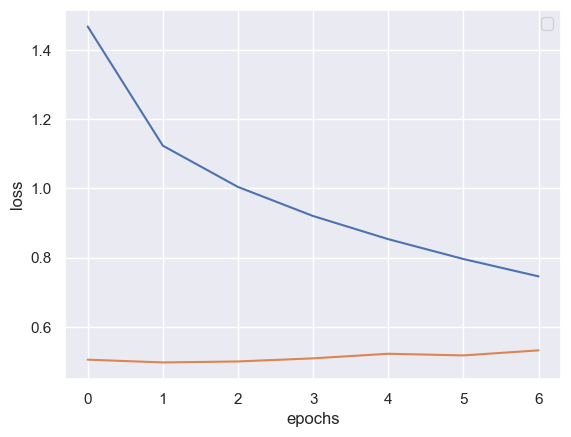

In [129]:
for label in [loss_plot,test_loss_plot]:
    plt.plot(label)
plt.legend()
plt.xlabel("epochs")
plt.ylabel("loss")
plt.show()

## Evaluating the Captioning Model: 
- The evaluate function is similar to the training loop, except we don't use Teacher Forcing here. The input to Decoder at each time step is its previous predictions, along with the hidden state and the ENCODER output.
- Few key points to remember while making predictions.
    1. Stop predicting when the model predicts the end token.
    2. Store the attention weights for every time step.

## Given below are two methods to evaluate the captions
1. Greedy Approach
2. Beam Search

- Now, instead of greedily choosing the next word we can choose the next word based on the word probability based on the beam size set using Beam search.

__Choose any one evaluate function as per your need__

## Greedy Approach

In [113]:
def evaluate(image):
    attention_plot = np.zeros((max_length, attention_features_shape))

    hidden = decoder.reset_state(batch_size=1)

    temp_input = tf.expand_dims(load_image(image)[0], 0)
    img_tensor_val = image_features_extract_model(temp_input)
    img_tensor_val = tf.reshape(img_tensor_val, (img_tensor_val.shape[0], -1, img_tensor_val.shape[3]))

    features = encoder(img_tensor_val)

    dec_input = tf.expand_dims([tokenizer.word_index['<start>']], 0) # Start token is <start> for LSTM
    result = []

    for i in range(max_length):
        predictions, hidden, attention_weights = decoder(dec_input, features, hidden)

        attention_plot[i] = tf.reshape(attention_weights, (-1, )).numpy()

        predicted_id = tf.argmax(predictions[0]).numpy()
        result.append(tokenizer.index_word[predicted_id]) # Store the result or word predicted

        if tokenizer.index_word[predicted_id] == '<end>': # if you reach <end> token then return the result
            return result, attention_plot

        dec_input = tf.expand_dims([predicted_id], 0) # Decoder input is the word predicted at previous timestep

    attention_plot = attention_plot[:len(result), :]
    return result, attention_plot

## Beam Search

In [114]:
def beamEvaluate(image, beam_index = 3):

    start = [tokenizer.word_index['<start>']]
    
    # result[0][0] = index of the starting word
    # result[0][1] = probability of the word predicted
    result = [[start, 0.0]]

    attention_plot = np.zeros((max_length, attention_features_shape))

    hidden = decoder.reset_state(batch_size=1)

    temp_input = tf.expand_dims(load_image(image)[0], 0)
    img_tensor_val = image_features_extract_model(temp_input)
    img_tensor_val = tf.reshape(img_tensor_val, (img_tensor_val.shape[0], -1, img_tensor_val.shape[3]))

    features = encoder(img_tensor_val)

    dec_input = tf.expand_dims([tokenizer.word_index['<start>']], 0)

    while len(result[0][0]) < max_length:
        i=0
        temp = []
        for s in result:

          predictions, hidden, attention_weights = decoder(dec_input, features, hidden)

          attention_plot[i] = tf.reshape(attention_weights, (-1, )).numpy()
          i=i+1
          # Getting the top <beam_index>(n) predictions
          word_preds = np.argsort(predictions[0])[-beam_index:]
          
          # creating a new list so as to put them via the model again
          for w in word_preds:       
            next_cap, prob = s[0][:], s[1]
            next_cap.append(w)
            prob += predictions[0][w]
            temp.append([next_cap, prob])
        result = temp
        # Sorting according to the probabilities
        result = sorted(result, reverse=False, key=lambda l: l[1])
        # Getting the top words
        result = result[-beam_index:]
        
        predicted_id = result[-1] # with Max Probability
        pred_list = predicted_id[0]
        
        prd_id = pred_list[-1] 
        if(prd_id!=3):
          dec_input = tf.expand_dims([prd_id], 0)  # Decoder input is the word predicted with highest probability among the top_k words predicted
        else:
          break

    result = result[-1][0]
    
    intermediate_caption = [tokenizer.index_word[i] for i in result]
    final_caption = []
    for i in intermediate_caption:
        if i != '<end>':
            final_caption.append(i)
            
        else:
            break

    attention_plot = attention_plot[:len(result), :]
    final_caption = ' '.join(final_caption[1:])
    return final_caption,attention_plot



###  helper function to visualise the attention points that predicts the words.

In [115]:
def plot_attention(image, result, attention_plot):
    temp_image = np.array(Image.open(image))

    fig = plt.figure(figsize=(10, 10))
    len_result = len(result)
    for l in range(len_result):
        temp_att = np.resize(attention_plot[l], (8, 8))
        ax = fig.add_subplot(len_result//2, len_result//2, l+1)
        ax.set_title(result[l])
        img = ax.imshow(temp_image)
        ax.imshow(temp_att, cmap='gray', alpha=0.6, extent=img.get_extent())

    plt.tight_layout()
    plt.show()

## Let's checkout few captions generated using Greedy Search vs Beam Search

### Greedy Search

In [134]:
real_caption = ' '.join([tokenizer.index_word[i] for i in caption_test[rid] if i not in [0]])
print(real_caption)

<start> dog is catching ball <end>


C:/Users/Vipul gaikwad/Desktop/College/Sem 6/Image-Captioning-using-Attention-Mechanism-Local-Attention-and-Global-Attention--master/dataset/Flicker8k_Dataset/544122267_e9e0100bc5.jpg
BELU score: 1.0923411962449183e-152
Real Caption: girl on swing in the park
Prediction Caption: girl plays on the swing


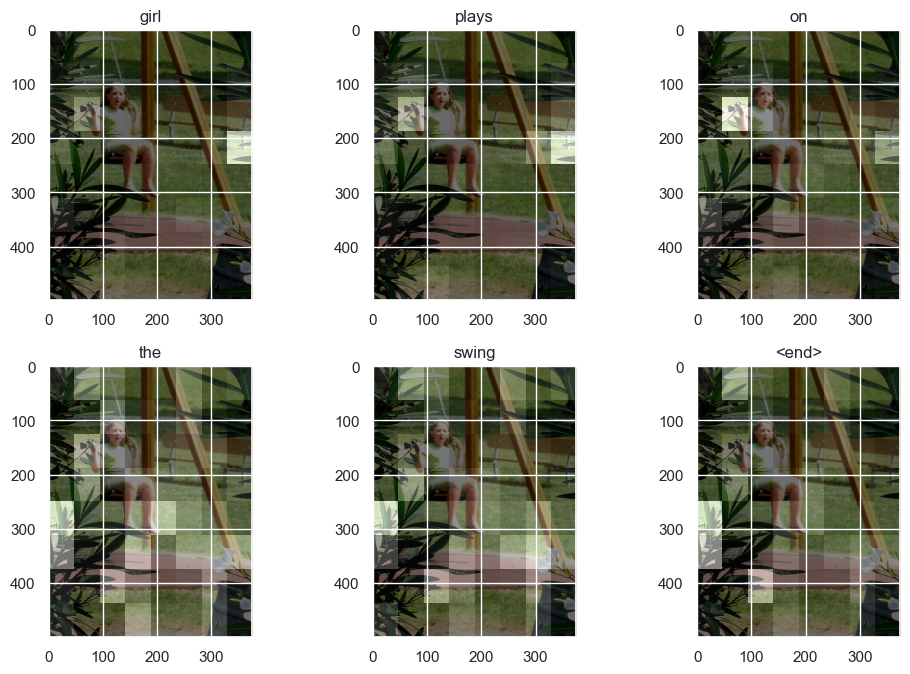

time took to Predict: 2 sec


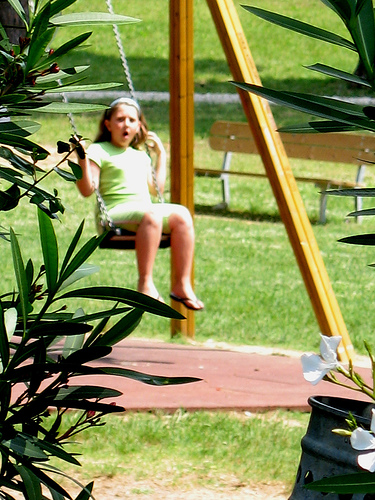

In [139]:
# captions on the validation set

from PIL import Image

from nltk.translate.bleu_score import sentence_bleu

rid = np.random.randint(0, len(img_name_test))
image = img_name_test[rid]
print(image)
start = time.time()
real_caption = ' '.join([tokenizer.index_word[i] for i in caption_test[rid] if i not in [0]])
result, attention_plot = evaluate(image)
# result is in this format:  ['woman', 'plays', 'volleyball', '<end>']
# We need to remove <end> and join the list elements into a sentence. Also we need to remove <unk> from real_captions


first = real_caption.split(' ', 1)[1]
real_caption = first.rsplit(' ', 1)[0]

#remove "<unk>" in result
for i in result:
    if i=="<unk>":
        result.remove(i)


#remove <end> from result         
result_join = ' '.join(result)
result_final = result_join.rsplit(' ', 1)[0]

real_appn = []
real_appn.append(real_caption.split())
reference = real_appn
candidate = result_final.split()

score = sentence_bleu(reference, candidate, weights=(0.5, 0.5, 0, 0))
print(f"BELU score: {score*100}")

print ('Real Caption:', real_caption)
print ('Prediction Caption:', result_final)

plot_attention(image, result, attention_plot)

print(f"time took to Predict: {round(time.time()-start)} sec")
# opening the image
Image.open(img_name_test[rid])

### Beam Search(b=3)

In [124]:
score = sentence_bleu('black dog is digging in the snow', 'dog is digging in the snow', weights=(0.5, 0.5, 0, 0))
print(f"BELU score: {score*100}")

BELU score: 9.702460521311574e-153


## Beam Search(b=7)

In [212]:
score = sentence_bleu('black dog is digging in the snow', 'the dog is digging in snow', weights=(0.5, 0.5, 0, 0))
print(f"BELU score: {score*100}")

BELU score: 65.04436355879909


C:/Users/Vipul gaikwad/Desktop/College/Sem 6/Image-Captioning-using-Attention-Mechanism-Local-Attention-and-Global-Attention--master/dataset/Flicker8k_Dataset/19212715_20476497a3.jpg
BELU score: 0
Prediction Caption(Beam=10): kayaker rows boat


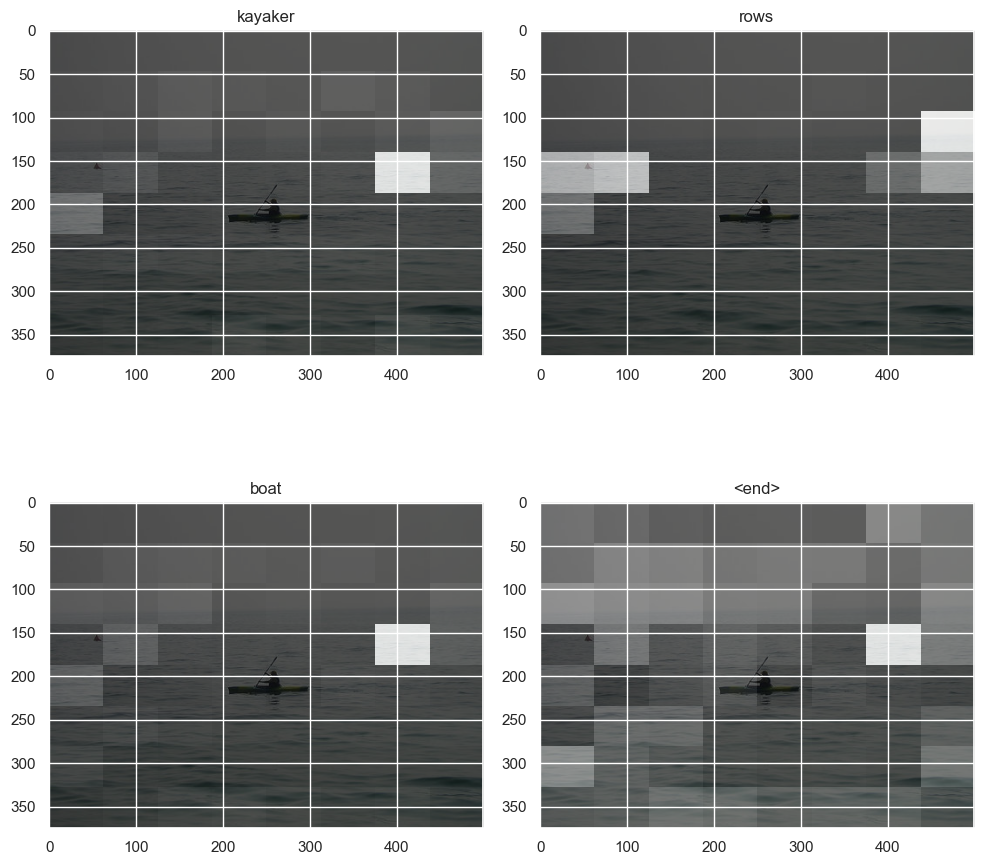

time took to Predict: 2 sec


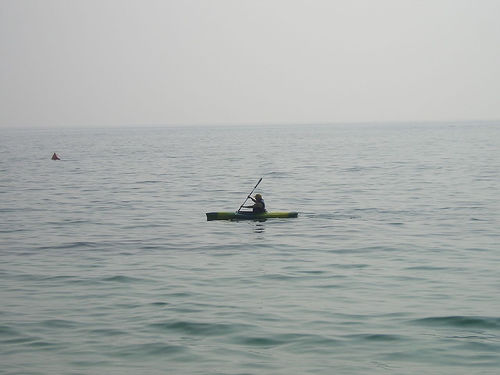

In [150]:
# captions on the validation set

from PIL import Image

from nltk.translate.bleu_score import sentence_bleu

rid = np.random.randint(0, len(img_name_test))
image = 'C:/Users/Vipul gaikwad/Desktop/College/Sem 6/Image-Captioning-using-Attention-Mechanism-Local-Attention-and-Global-Attention--master/dataset/Flicker8k_Dataset/19212715_20476497a3.jpg'
print(image)
start = time.time()
real_caption = '<start> kayaker rows boat <end>'
result, attention_plot = evaluate(image)
# result is in this format:  ['woman', 'plays', 'volleyball', '<end>']
# We need to remove <end> and join the list elements into a sentence. Also we need to remove <unk> from real_captions


first = real_caption.split(' ', 1)[1]
real_caption = first.rsplit(' ', 1)[0]

#remove "<unk>" in result
for i in result:
    if i=="<unk>":
        result.remove(i)


#remove <end> from result         
result_join = ' '.join(result)
result_final = result_join.rsplit(' ', 1)[0]

real_appn = []
real_appn.append(real_caption.split())
reference = real_appn
candidate = result_final.split()

score = sentence_bleu(reference, candidate, weights=(0.5, 0.5, 0, 0))
print(f"BELU score: {score*100}")

#print ('Real Caption:', real_caption)
print ('Prediction Caption(Beam=10):', result_final)

plot_attention(image, result, attention_plot)

print(f"time took to Predict: {round(time.time()-start)} sec")
# opening the image
Image.open('C:/Users/Vipul gaikwad/Desktop/College/Sem 6/Image-Captioning-using-Attention-Mechanism-Local-Attention-and-Global-Attention--master/dataset/Flicker8k_Dataset/19212715_20476497a3.jpg')

## Beam Search(b=10)

C:/Users/Vipul gaikwad/Desktop/College/Sem 6/Image-Captioning-using-Attention-Mechanism-Local-Attention-and-Global-Attention--master/dataset/Flicker8k_Dataset/10815824_2997e03d76.jpg
BELU score: 0
Prediction Caption(Beam=10): two horses and riders are outside


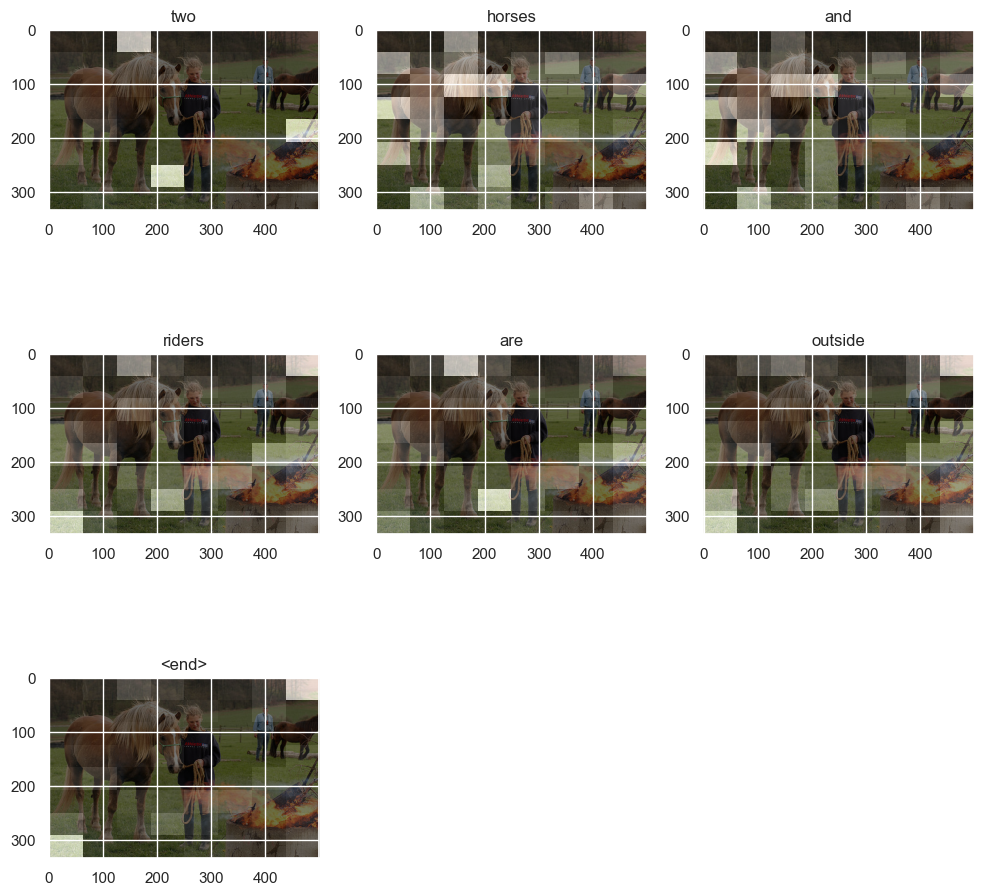

time took to Predict: 2 sec


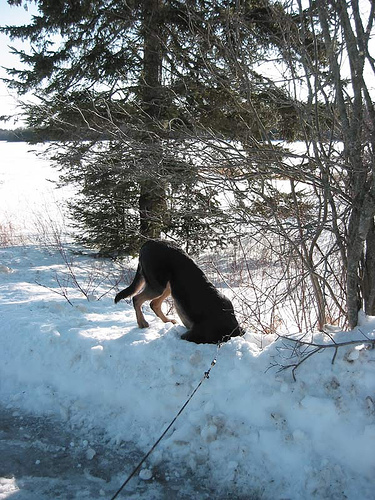

In [146]:
# captions on the validation set

from PIL import Image

from nltk.translate.bleu_score import sentence_bleu

rid = np.random.randint(0, len(img_name_test))
image = 'C:/Users/Vipul gaikwad/Desktop/College/Sem 6/Image-Captioning-using-Attention-Mechanism-Local-Attention-and-Global-Attention--master/dataset/Flicker8k_Dataset/10815824_2997e03d76.jpg'
print(image)
start = time.time()
real_caption = '<start> two horses and riders are outside <end>'
result, attention_plot = evaluate(image)
# result is in this format:  ['woman', 'plays', 'volleyball', '<end>']
# We need to remove <end> and join the list elements into a sentence. Also we need to remove <unk> from real_captions


first = real_caption.split(' ', 1)[1]
real_caption = first.rsplit(' ', 1)[0]

#remove "<unk>" in result
for i in result:
    if i=="<unk>":
        result.remove(i)


#remove <end> from result         
result_join = ' '.join(result)
result_final = result_join.rsplit(' ', 1)[0]

real_appn = []
real_appn.append(real_caption.split())
reference = real_appn
candidate = result_final.split()

score = sentence_bleu(reference, candidate, weights=(0.5, 0.5, 0, 0))
print(f"BELU score: {score*100}")

#print ('Real Caption:', real_caption)
print ('Prediction Caption(Beam=10):', result_final)

plot_attention(image, result, attention_plot)

print(f"time took to Predict: {round(time.time()-start)} sec")
# opening the image
Image.open('C:/Users/Vipul gaikwad/Desktop/College/Sem 6/Image-Captioning-using-Attention-Mechanism-Local-Attention-and-Global-Attention--master/dataset/Flicker8k_Dataset/413231421_43833a11f5.jpg')

### Greedy Search

Flicker8k_Dataset/3014015906_fdba461f36.jpg
BELU score: 45.673553902495044
Real Caption: three people walking along a stream in a jungle
Prediction Caption: three people are walking along a rocky mountain


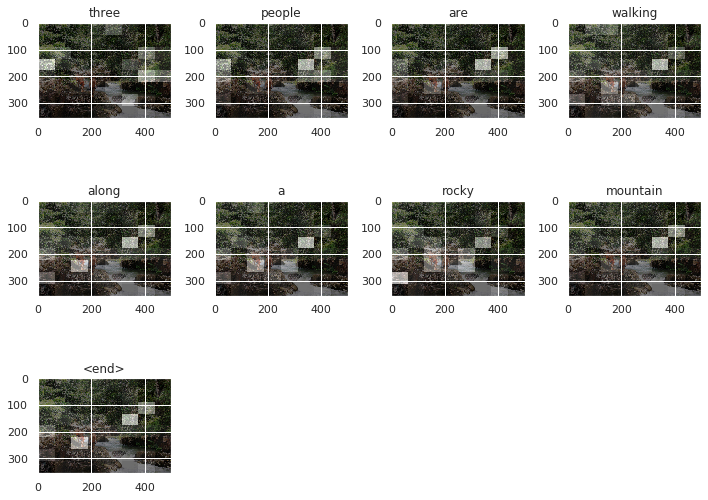

time took to Predict: 3 sec


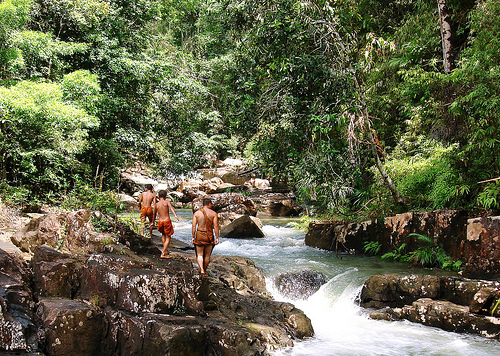

In [222]:
# captions on the validation set

from PIL import Image

from nltk.translate.bleu_score import sentence_bleu

rid = np.random.randint(0, len(img_name_test))
image = img_name_test[rid]
print(image)
start = time.time()
real_caption = ' '.join([tokenizer.index_word[i] for i in caption_test[rid] if i not in [0]])
result, attention_plot = evaluate(image)
# result is in this format:  ['woman', 'plays', 'volleyball', '<end>']
# We need to remove <end> and join the list elements into a sentence. Also we need to remove <unk> from real_captions


first = real_caption.split(' ', 1)[1]
real_caption = first.rsplit(' ', 1)[0]

#remove "<unk>" in result
for i in result:
    if i=="<unk>":
        result.remove(i)


#remove <end> from result         
result_join = ' '.join(result)
result_final = result_join.rsplit(' ', 1)[0]

real_appn = []
real_appn.append(real_caption.split())
reference = real_appn
candidate = result_final.split()

score = sentence_bleu(reference, candidate, weights=(0.5, 0.5, 0, 0))
print(f"BELU score: {score*100}")

print ('Real Caption:', real_caption)
print ('Prediction Caption:', result_final)

plot_attention(image, result, attention_plot)

print(f"time took to Predict: {round(time.time()-start)} sec")
# opening the image
Image.open(img_name_test[rid])

## Beam Search(b=3)

Flicker8k_Dataset/3014015906_fdba461f36.jpg
BELU score: 49.19573683654302
Real Caption: three people walking along a stream in a jungle
Prediction Caption(Beam=3): four people are walking on a mountain


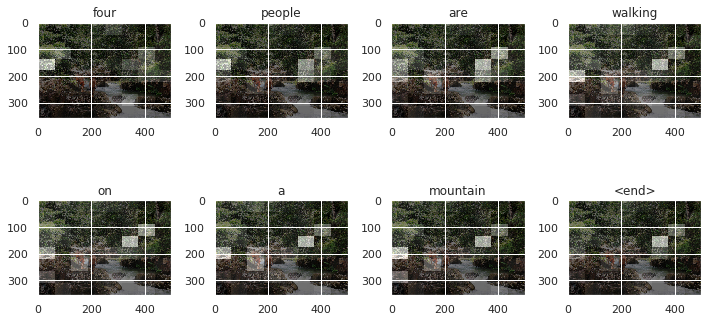

time took to Predict: 3 sec


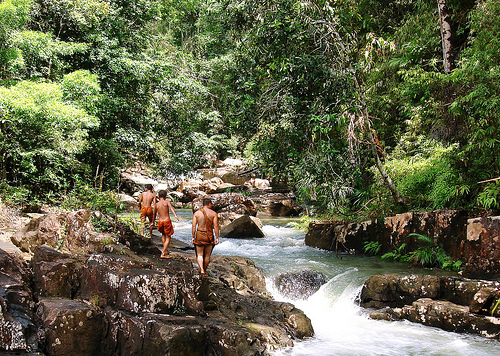

In [225]:
# captions on the validation set

from PIL import Image

from nltk.translate.bleu_score import sentence_bleu

rid = np.random.randint(0, len(img_name_test))
image = 'Flicker8k_Dataset/3014015906_fdba461f36.jpg'
print(image)
start = time.time()
real_caption = '<start> three people walking along a stream in a jungle <end>'
result, attention_plot = evaluate(image)
# result is in this format:  ['woman', 'plays', 'volleyball', '<end>']
# We need to remove <end> and join the list elements into a sentence. Also we need to remove <unk> from real_captions


first = real_caption.split(' ', 1)[1]
real_caption = first.rsplit(' ', 1)[0]

#remove "<unk>" in result
for i in result:
    if i=="<unk>":
        result.remove(i)


#remove <end> from result         
result_join = ' '.join(result)
result_final = result_join.rsplit(' ', 1)[0]

real_appn = []
real_appn.append(real_caption.split())
reference = real_appn
candidate = result_final.split()

score = sentence_bleu(reference, candidate, weights=(0.5, 0.5, 0, 0))
print(f"BELU score: {score*100}")

print ('Real Caption:', real_caption)
print ('Prediction Caption(Beam=3):', result_final)

plot_attention(image, result, attention_plot)

print(f"time took to Predict: {round(time.time()-start)} sec")
# opening the image
Image.open('Flicker8k_Dataset/3014015906_fdba461f36.jpg')

## Beam Search(b=7)

Flicker8k_Dataset/3014015906_fdba461f36.jpg
BELU score: 45.673553902495044
Real Caption: three people walking along a stream in a jungle
Prediction Caption(Beam=7): three people are walking along a rocky mountain


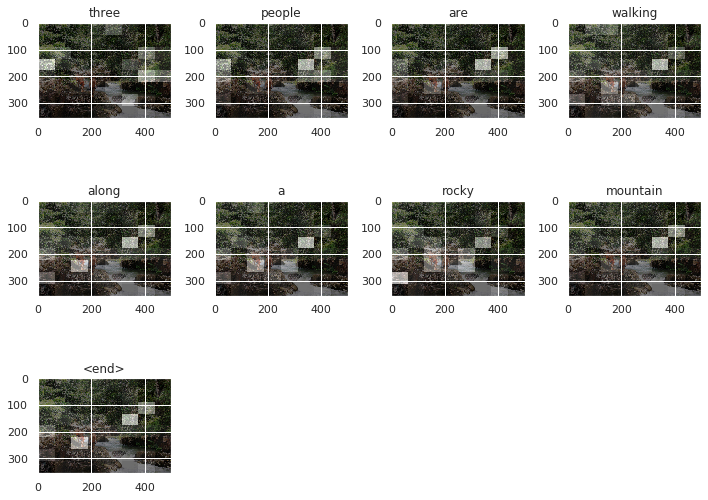

time took to Predict: 3 sec


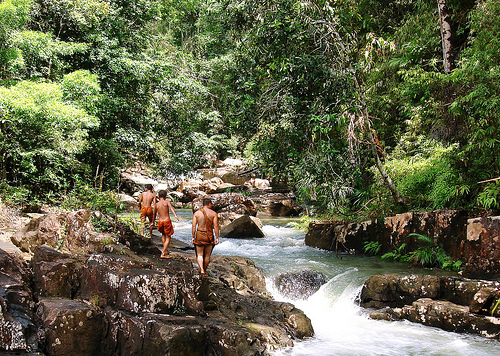

In [228]:
# captions on the validation set

from PIL import Image

from nltk.translate.bleu_score import sentence_bleu

rid = np.random.randint(0, len(img_name_test))
image = 'Flicker8k_Dataset/3014015906_fdba461f36.jpg'
print(image)
start = time.time()
real_caption = '<start> three people walking along a stream in a jungle <end>'
result, attention_plot = evaluate(image)
# result is in this format:  ['woman', 'plays', 'volleyball', '<end>']
# We need to remove <end> and join the list elements into a sentence. Also we need to remove <unk> from real_captions


first = real_caption.split(' ', 1)[1]
real_caption = first.rsplit(' ', 1)[0]

#remove "<unk>" in result
for i in result:
    if i=="<unk>":
        result.remove(i)


#remove <end> from result         
result_join = ' '.join(result)
result_final = result_join.rsplit(' ', 1)[0]

real_appn = []
real_appn.append(real_caption.split())
reference = real_appn
candidate = result_final.split()

score = sentence_bleu(reference, candidate, weights=(0.5, 0.5, 0, 0))
print(f"BELU score: {score*100}")

print ('Real Caption:', real_caption)
print ('Prediction Caption(Beam=7):', result_final)

plot_attention(image, result, attention_plot)

print(f"time took to Predict: {round(time.time()-start)} sec")
# opening the image
Image.open('Flicker8k_Dataset/3014015906_fdba461f36.jpg')

## Beam Search(b=10)

Flicker8k_Dataset/3014015906_fdba461f36.jpg
BELU score: 23.19109274839227
Real Caption: three people walking along a stream in a jungle
Prediction Caption(Beam=10): three people are walking across a river


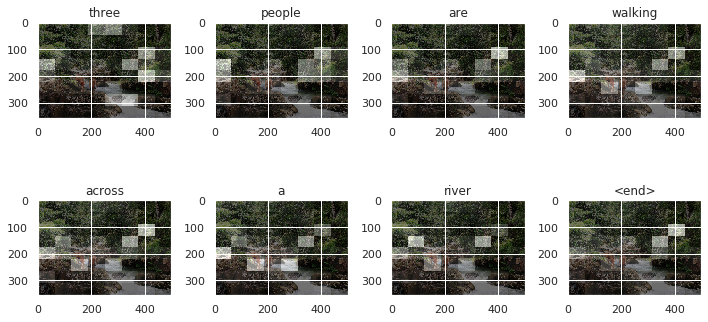

time took to Predict: 3 sec


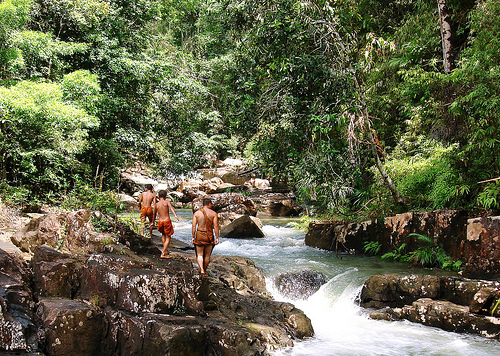

In [230]:
# captions on the validation set

from PIL import Image

from nltk.translate.bleu_score import sentence_bleu

rid = np.random.randint(0, len(img_name_test))
image = 'Flicker8k_Dataset/3014015906_fdba461f36.jpg'
print(image)
start = time.time()
real_caption = '<start> three people walking along a stream in a jungle <end>'
result, attention_plot = evaluate(image)
# result is in this format:  ['woman', 'plays', 'volleyball', '<end>']
# We need to remove <end> and join the list elements into a sentence. Also we need to remove <unk> from real_captions


first = real_caption.split(' ', 1)[1]
real_caption = first.rsplit(' ', 1)[0]

#remove "<unk>" in result
for i in result:
    if i=="<unk>":
        result.remove(i)


#remove <end> from result         
result_join = ' '.join(result)
result_final = result_join.rsplit(' ', 1)[0]

real_appn = []
real_appn.append(real_caption.split())
reference = real_appn
candidate = result_final.split()

score = sentence_bleu(reference, candidate, weights=(0.5, 0.5, 0, 0))
print(f"BELU score: {score*100}")

print ('Real Caption:', real_caption)
print ('Prediction Caption(Beam=10):', result_final)

plot_attention(image, result, attention_plot)

print(f"time took to Predict: {round(time.time()-start)} sec")
# opening the image
Image.open('Flicker8k_Dataset/3014015906_fdba461f36.jpg')

## Try captions on Validation Set

### Greedy Search

Flicker8k_Dataset/1240297429_c36ae0c58f.jpg
BELU score: 23.145502494313785
Real Caption: white and tan dog leaps through the air
Prediction Caption: dog in harness is running through the grass


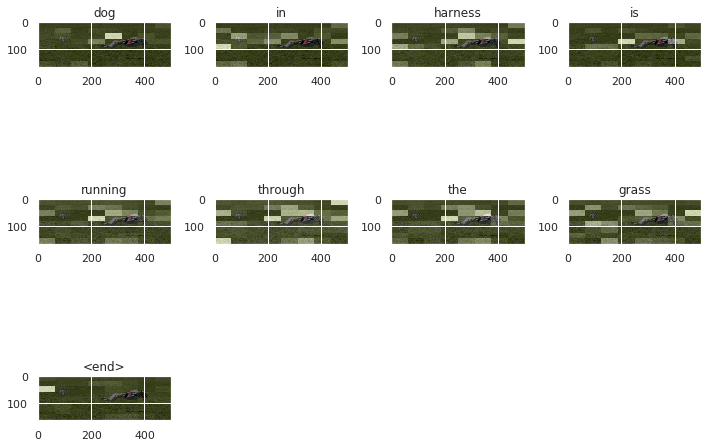

time took to Predict: 2 sec


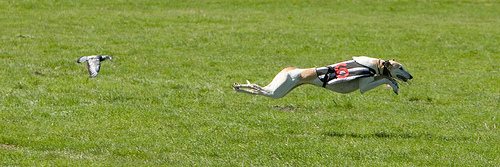

In [138]:
# captions on the validation set

from PIL import Image

from nltk.translate.bleu_score import sentence_bleu

rid = np.random.randint(0, len(img_name_test))
image = img_name_test[rid]
print(image)
start = time.time()
real_caption = ' '.join([tokenizer.index_word[i] for i in caption_test[rid] if i not in [0]])
result, attention_plot = evaluate(image)
# result is in this format:  ['woman', 'plays', 'volleyball', '<end>']
# We need to remove <end> and join the list elements into a sentence. Also we need to remove <unk> from real_captions


first = real_caption.split(' ', 1)[1]
real_caption = first.rsplit(' ', 1)[0]

#remove "<unk>" in result
for i in result:
    if i=="<unk>":
        result.remove(i)


#remove <end> from result         
result_join = ' '.join(result)
result_final = result_join.rsplit(' ', 1)[0]

real_appn = []
real_appn.append(real_caption.split())
reference = real_appn
candidate = result_final.split()

score = sentence_bleu(reference, candidate, weights=(0.5, 0.5, 0, 0))
print(f"BELU score: {score*100}")

print ('Real Caption:', real_caption)
print ('Prediction Caption:', result_final)

plot_attention(image, result, attention_plot)

print(f"time took to Predict: {round(time.time()-start)} sec")
# opening the image
Image.open(img_name_test[rid])

### Beam Search(b=3)

Flicker8k_Dataset/1240297429_c36ae0c58f.jpg
BELU score: 20.960166113993736
Real Caption: the lady and child walk to school in the rain
Prediction Caption(Beam=3): dog is leaping through the grass


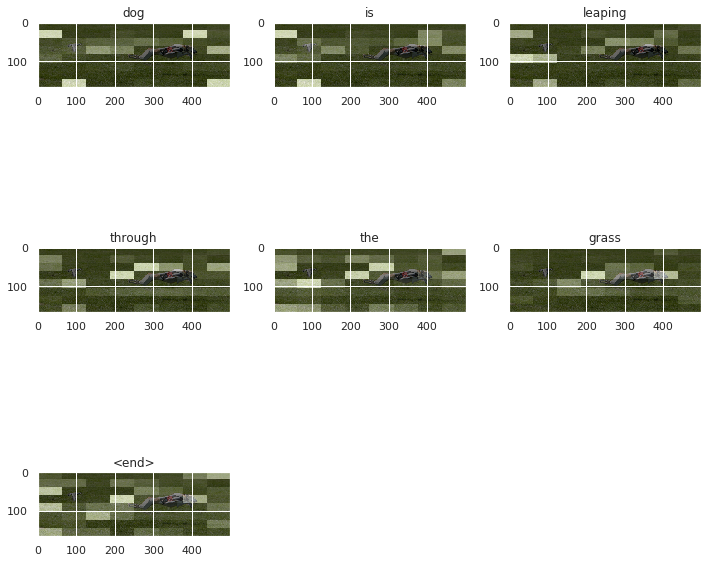

time took to Predict: 3 sec


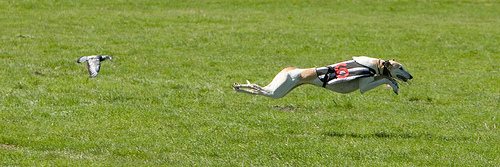

In [103]:
# captions on the validation set

from PIL import Image

from nltk.translate.bleu_score import sentence_bleu

rid = np.random.randint(0, len(img_name_test))
image = 'Flicker8k_Dataset/1240297429_c36ae0c58f.jpg'
print(image)
start = time.time()
real_caption = ' '.join([tokenizer.index_word[i] for i in caption_test[rid] if i not in [0]])
result, attention_plot = evaluate(image)
# result is in this format:  ['woman', 'plays', 'volleyball', '<end>']
# We need to remove <end> and join the list elements into a sentence. Also we need to remove <unk> from real_captions


first = real_caption.split(' ', 1)[1]
real_caption = first.rsplit(' ', 1)[0]

#remove "<unk>" in result
for i in result:
    if i=="<unk>":
        result.remove(i)


#remove <end> from result         
result_join = ' '.join(result)
result_final = result_join.rsplit(' ', 1)[0]

real_appn = []
real_appn.append(real_caption.split())
reference = real_appn
candidate = result_final.split()

score = sentence_bleu(reference, candidate, weights=(0.5, 0.5, 0, 0))
print(f"BELU score: {score*100}")

print ('Real Caption:', real_caption)
print ('Prediction Caption(Beam=3):', result_final)

plot_attention(image, result, attention_plot)

print(f"time took to Predict: {round(time.time()-start)} sec")
# opening the image
Image.open('Flicker8k_Dataset/1240297429_c36ae0c58f.jpg')

In [214]:
score = sentence_bleu('white and tan dog leaps through the air', 'dog is leaping through the grass', weights=(0.5, 0.5, 0, 0))
print(f"BELU score: {score*100}")

BELU score: 68.46531968814577


## Beam Search(b=7)

Flicker8k_Dataset/1240297429_c36ae0c58f.jpg
BELU score: 51.78107940302672
Prediction Caption(Beam=7): dog is leaping through field


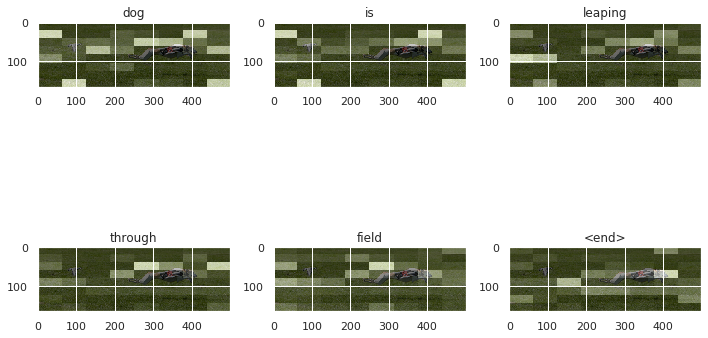

time took to Predict: 2 sec


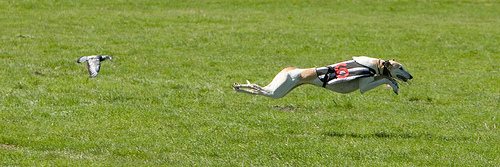

In [115]:
# captions on the validation set

from PIL import Image

from nltk.translate.bleu_score import sentence_bleu

rid = np.random.randint(0, len(img_name_test))
image = 'Flicker8k_Dataset/1240297429_c36ae0c58f.jpg'
print(image)
start = time.time()
real_caption = ' '.join([tokenizer.index_word[i] for i in caption_test[rid] if i not in [0]])
result, attention_plot = evaluate(image)
# result is in this format:  ['woman', 'plays', 'volleyball', '<end>']
# We need to remove <end> and join the list elements into a sentence. Also we need to remove <unk> from real_captions


first = real_caption.split(' ', 1)[1]
real_caption = first.rsplit(' ', 1)[0]

#remove "<unk>" in result
for i in result:
    if i=="<unk>":
        result.remove(i)


#remove <end> from result         
result_join = ' '.join(result)
result_final = result_join.rsplit(' ', 1)[0]

real_appn = []
real_appn.append(real_caption.split())
reference = real_appn
candidate = result_final.split()

score = sentence_bleu(reference, candidate, weights=(0.5, 0.5, 0, 0))
print(f"BELU score: {score*100}")

#print ('Real Caption:', real_caption)
print ('Prediction Caption(Beam=7):', result_final)

plot_attention(image, result, attention_plot)

print(f"time took to Predict: {round(time.time()-start)} sec")
# opening the image
Image.open('Flicker8k_Dataset/1240297429_c36ae0c58f.jpg')

In [215]:
score = sentence_bleu('white and tan dog leaps through the air', 'dog is leaping through field', weights=(0.5, 0.5, 0, 0))
print(f"BELU score: {score*100}")

BELU score: 73.19250547114


## Beam Search(b=10)

Flicker8k_Dataset/1240297429_c36ae0c58f.jpg
BELU score: 50.0
Prediction Caption(Beam=10): a dog is running through a grassy field


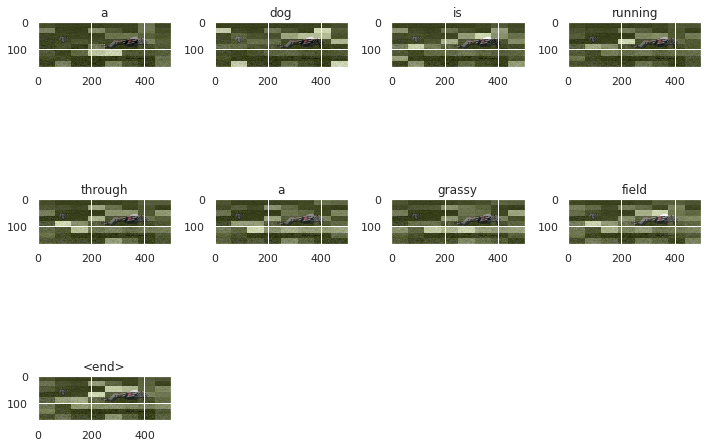

time took to Predict: 3 sec


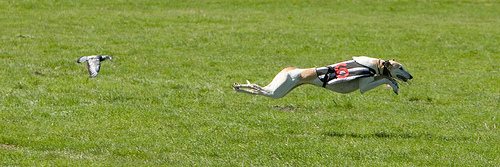

In [207]:
# captions on the validation set

from PIL import Image

from nltk.translate.bleu_score import sentence_bleu

rid = np.random.randint(0, len(img_name_test))
image = 'Flicker8k_Dataset/1240297429_c36ae0c58f.jpg'
print(image)
start = time.time()
real_caption = '<start> white and tan dog leaps through the air <end>'
result, attention_plot = evaluate(image)
# result is in this format:  ['woman', 'plays', 'volleyball', '<end>']
# We need to remove <end> and join the list elements into a sentence. Also we need to remove <unk> from real_captions


first = real_caption.split(' ', 1)[1]
real_caption = first.rsplit(' ', 1)[0]

#remove "<unk>" in result
for i in result:
    if i=="<unk>":
        result.remove(i)


#remove <end> from result         
result_join = ' '.join(result)
result_final = result_join.rsplit(' ', 1)[0]

real_appn = []
real_appn.append(real_caption.split())
reference = real_appn
candidate = result_final.split()

score = sentence_bleu(reference, candidate, weights=(0.5, 0.5, 0, 0))
print(f"BELU score: {score*100}")

#print ('Real Caption:', real_caption)
print ('Prediction Caption(Beam=10):', result_final)

plot_attention(image, result, attention_plot)

print(f"time took to Predict: {round(time.time()-start)} sec")
# opening the image
Image.open('Flicker8k_Dataset/1240297429_c36ae0c58f.jpg')

### Greedy Search

Flicker8k_Dataset/270809922_043e3bef06.jpg
BELU score: 53.45224838248488
Real Caption: lone man climbing high on snowy mountain
Prediction Caption: man is standing on top of glacier


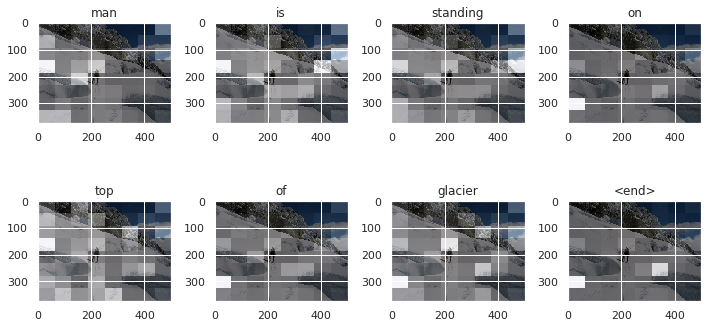

time took to Predict: 7 sec


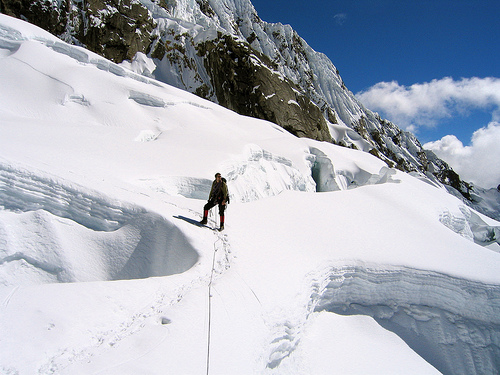

In [92]:
# captions on the validation set

from PIL import Image

from nltk.translate.bleu_score import sentence_bleu

rid = np.random.randint(0, len(img_name_test))
image = img_name_test[rid]
print(image)
start = time.time()
real_caption = ' '.join([tokenizer.index_word[i] for i in caption_test[rid] if i not in [0]])
result, attention_plot = evaluate(image)
# result is in this format:  ['woman', 'plays', 'volleyball', '<end>']
# We need to remove <end> and join the list elements into a sentence. Also we need to remove <unk> from real_captions


first = real_caption.split(' ', 1)[1]
real_caption = first.rsplit(' ', 1)[0]

#remove "<unk>" in result
for i in result:
    if i=="<unk>":
        result.remove(i)


#remove <end> from result         
result_join = ' '.join(result)
result_final = result_join.rsplit(' ', 1)[0]

real_appn = []
real_appn.append(real_caption.split())
reference = real_appn
candidate = result_final.split()

score = sentence_bleu(reference, candidate, weights=(0.5, 0.5, 0, 0))
print(f"BELU score: {score*100}")

print ('Real Caption:', real_caption)
print ('Prediction Caption:', result_final)

plot_attention(image, result, attention_plot)

print(f"time took to Predict: {round(time.time()-start)} sec")
# opening the image
Image.open(img_name_test[rid])

## Beam Search(b=3)

Flicker8k_Dataset/270809922_043e3bef06.jpg
BELU score: 0
Real Caption: white dog with dark markings jumping to catch an object
Prediction Caption(Beam=3): man is standing on top of glacier


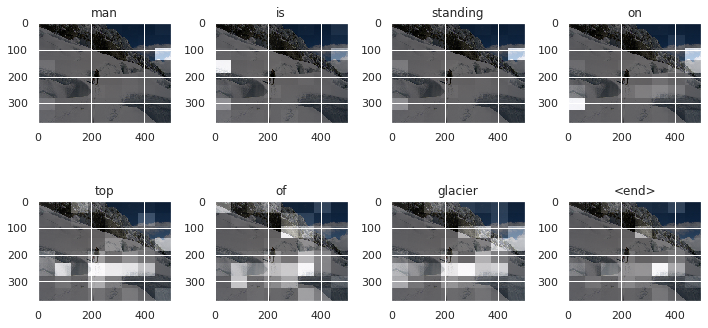

time took to Predict: 3 sec


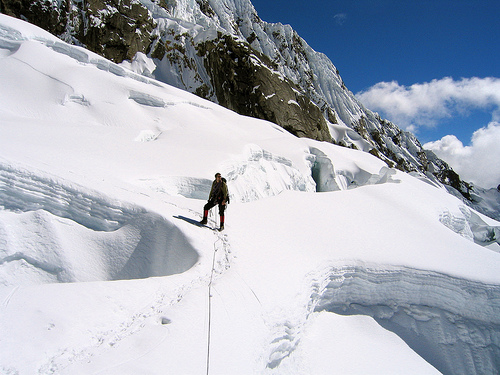

In [104]:
# captions on the validation set

from PIL import Image

from nltk.translate.bleu_score import sentence_bleu

rid = np.random.randint(0, len(img_name_test))
image = 'Flicker8k_Dataset/270809922_043e3bef06.jpg'
print(image)
start = time.time()
real_caption = ' '.join([tokenizer.index_word[i] for i in caption_test[rid] if i not in [0]])
result, attention_plot = evaluate(image)
# result is in this format:  ['woman', 'plays', 'volleyball', '<end>']
# We need to remove <end> and join the list elements into a sentence. Also we need to remove <unk> from real_captions


first = real_caption.split(' ', 1)[1]
real_caption = first.rsplit(' ', 1)[0]

#remove "<unk>" in result
for i in result:
    if i=="<unk>":
        result.remove(i)


#remove <end> from result         
result_join = ' '.join(result)
result_final = result_join.rsplit(' ', 1)[0]

real_appn = []
real_appn.append(real_caption.split())
reference = real_appn
candidate = result_final.split()

score = sentence_bleu(reference, candidate, weights=(0.5, 0.5, 0, 0))
print(f"BELU score: {score*100}")

print ('Real Caption:', real_caption)
print ('Prediction Caption(Beam=3):', result_final)

plot_attention(image, result, attention_plot)

print(f"time took to Predict: {round(time.time()-start)} sec")
# opening the image
Image.open('Flicker8k_Dataset/270809922_043e3bef06.jpg')

In [216]:
score = sentence_bleu('lone man climbing high on snowy mountain', 'man is standing on top of glacier', weights=(0.5, 0.5, 0, 0))
print(f"BELU score: {score*100}")

BELU score: 60.30226891555272


## Beam Search(b=7)

Flicker8k_Dataset/270809922_043e3bef06.jpg
BELU score: 8.100533543212128
Prediction Caption(Beam=7): man is standing in the snow


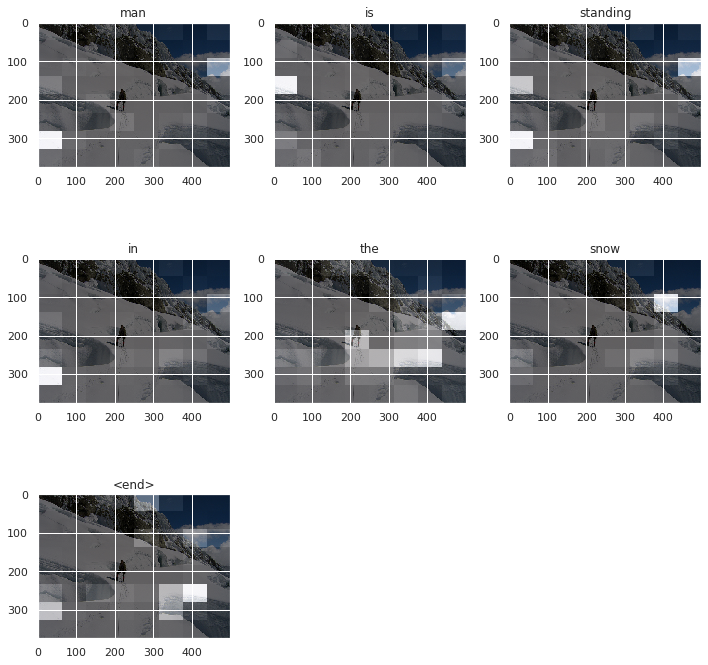

time took to Predict: 3 sec


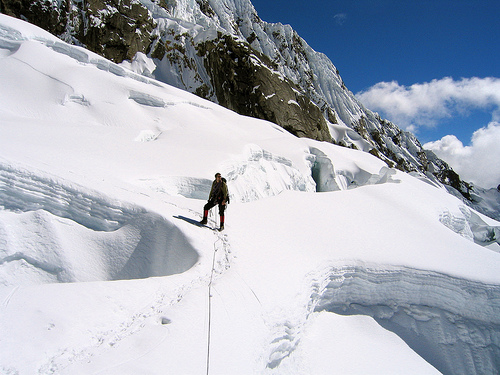

In [116]:
# captions on the validation set

from PIL import Image

from nltk.translate.bleu_score import sentence_bleu

rid = np.random.randint(0, len(img_name_test))
image = 'Flicker8k_Dataset/270809922_043e3bef06.jpg'
print(image)
start = time.time()
real_caption = ' '.join([tokenizer.index_word[i] for i in caption_test[rid] if i not in [0]])
result, attention_plot = evaluate(image)
# result is in this format:  ['woman', 'plays', 'volleyball', '<end>']
# We need to remove <end> and join the list elements into a sentence. Also we need to remove <unk> from real_captions


first = real_caption.split(' ', 1)[1]
real_caption = first.rsplit(' ', 1)[0]

#remove "<unk>" in result
for i in result:
    if i=="<unk>":
        result.remove(i)


#remove <end> from result         
result_join = ' '.join(result)
result_final = result_join.rsplit(' ', 1)[0]

real_appn = []
real_appn.append(real_caption.split())
reference = real_appn
candidate = result_final.split()

score = sentence_bleu(reference, candidate, weights=(0.5, 0.5, 0, 0))
print(f"BELU score: {score*100}")

#print ('Real Caption:', real_caption)
print ('Prediction Caption(Beam=7):', result_final)

plot_attention(image, result, attention_plot)

print(f"time took to Predict: {round(time.time()-start)} sec")
# opening the image
Image.open('Flicker8k_Dataset/270809922_043e3bef06.jpg')

In [217]:
score = sentence_bleu('lone man climbing high on snowy mountain', 'man is standing in the snow', weights=(0.5, 0.5, 0, 0))
print(f"BELU score: {score*100}")

BELU score: 66.66666666666666


In [156]:
 decoder2 = Rnn_Global_Decoder(embedding_dim, units, vocab_size,scoring_type)

### Greedy Search

Flicker8k_Dataset/69189650_6687da7280.jpg
BELU score: 15.092726661824571
Real Caption: brown dog with his tongue <unk> as he runs through field
Prediction Caption: brown dog is running through the camera


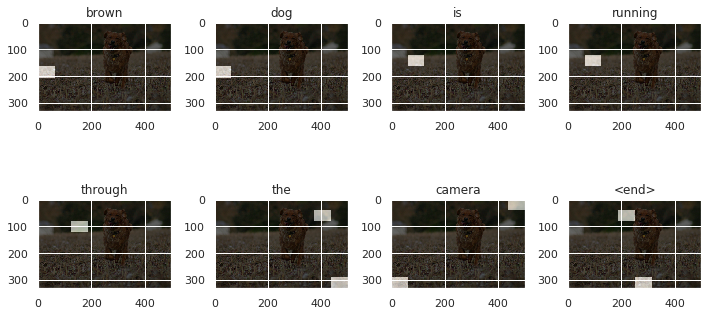

time took to Predict: 3 sec


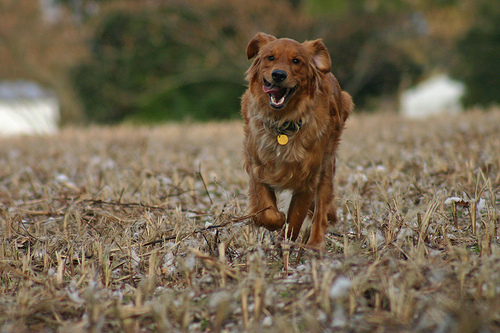

In [98]:
# captions on the validation set

from PIL import Image

from nltk.translate.bleu_score import sentence_bleu

rid = np.random.randint(0, len(img_name_test))
image = img_name_test[rid]
print(image)
start = time.time()
real_caption = ' '.join([tokenizer.index_word[i] for i in caption_test[rid] if i not in [0]])
result, attention_plot = evaluate(image)
# result is in this format:  ['woman', 'plays', 'volleyball', '<end>']
# We need to remove <end> and join the list elements into a sentence. Also we need to remove <unk> from real_captions


first = real_caption.split(' ', 1)[1]
real_caption = first.rsplit(' ', 1)[0]

#remove "<unk>" in result
for i in result:
    if i=="<unk>":
        result.remove(i)


#remove <end> from result         
result_join = ' '.join(result)
result_final = result_join.rsplit(' ', 1)[0]

real_appn = []
real_appn.append(real_caption.split())
reference = real_appn
candidate = result_final.split()

score = sentence_bleu(reference, candidate, weights=(0.5, 0.5, 0, 0))
print(f"BELU score: {score*100}")

print ('Real Caption:', real_caption)
print ('Prediction Caption:', result_final)

plot_attention(image, result, attention_plot)

print(f"time took to Predict: {round(time.time()-start)} sec")
# opening the image
Image.open(img_name_test[rid])

## Beam Search(b=3)

Flicker8k_Dataset/69189650_6687da7280.jpg
BELU score: 26.167102380212114
Real Caption: long haired dog walks out of the water and licks his nose
Prediction Caption(Beam=3): brown dog is running through the grass


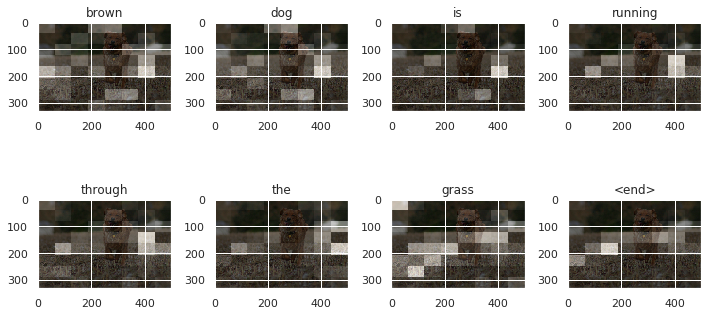

time took to Predict: 3 sec


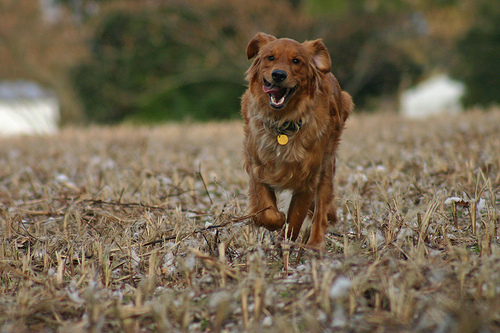

In [108]:
# captions on the validation set

from PIL import Image

from nltk.translate.bleu_score import sentence_bleu

rid = np.random.randint(0, len(img_name_test))
image = 'Flicker8k_Dataset/69189650_6687da7280.jpg'
print(image)
start = time.time()
real_caption = ' '.join([tokenizer.index_word[i] for i in caption_test[rid] if i not in [0]])
result, attention_plot = evaluate(image)
# result is in this format:  ['woman', 'plays', 'volleyball', '<end>']
# We need to remove <end> and join the list elements into a sentence. Also we need to remove <unk> from real_captions


first = real_caption.split(' ', 1)[1]
real_caption = first.rsplit(' ', 1)[0]

#remove "<unk>" in result
for i in result:
    if i=="<unk>":
        result.remove(i)


#remove <end> from result         
result_join = ' '.join(result)
result_final = result_join.rsplit(' ', 1)[0]

real_appn = []
real_appn.append(real_caption.split())
reference = real_appn
candidate = result_final.split()

score = sentence_bleu(reference, candidate, weights=(0.5, 0.5, 0, 0))
print(f"BELU score: {score*100}")

print ('Real Caption:', real_caption)
print ('Prediction Caption(Beam=3):', result_final)

plot_attention(image, result, attention_plot)

print(f"time took to Predict: {round(time.time()-start)} sec")
# opening the image
Image.open('Flicker8k_Dataset/69189650_6687da7280.jpg')

In [218]:
score = sentence_bleu('brown dog with his tongue <unk> as he runs through field', 'brown dog is running through the grass', weights=(0.5, 0.5, 0, 0))
print(f"BELU score: {score*100}")

BELU score: 62.82808624375432


## Beam Search(b=7)

Flicker8k_Dataset/69189650_6687da7280.jpg
BELU score: 37.79644730092272
Prediction Caption(Beam=7): brown dog is running through the grass with his tongue out of grass with an orange toy in the dead leaves


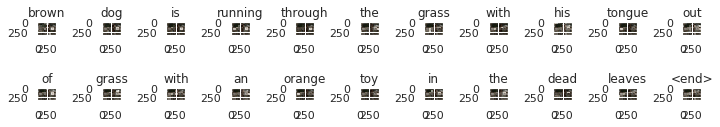

time took to Predict: 7 sec


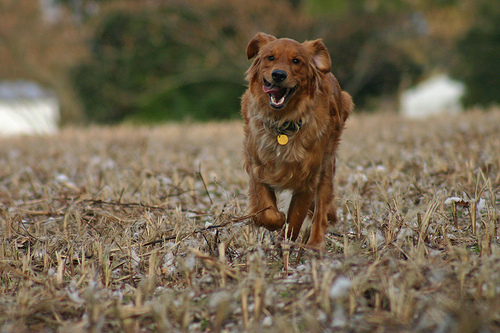

In [117]:
# captions on the validation set

from PIL import Image

from nltk.translate.bleu_score import sentence_bleu

rid = np.random.randint(0, len(img_name_test))
image = 'Flicker8k_Dataset/69189650_6687da7280.jpg'
print(image)
start = time.time()
real_caption = ' '.join([tokenizer.index_word[i] for i in caption_test[rid] if i not in [0]])
result, attention_plot = evaluate(image)
# result is in this format:  ['woman', 'plays', 'volleyball', '<end>']
# We need to remove <end> and join the list elements into a sentence. Also we need to remove <unk> from real_captions


first = real_caption.split(' ', 1)[1]
real_caption = first.rsplit(' ', 1)[0]

#remove "<unk>" in result
for i in result:
    if i=="<unk>":
        result.remove(i)


#remove <end> from result         
result_join = ' '.join(result)
result_final = result_join.rsplit(' ', 1)[0]

real_appn = []
real_appn.append(real_caption.split())
reference = real_appn
candidate = result_final.split()

score = sentence_bleu(reference, candidate, weights=(0.5, 0.5, 0, 0))
print(f"BELU score: {score*100}")

#print ('Real Caption:', real_caption)
print ('Prediction Caption(Beam=7):', result_final)

plot_attention(image, result, attention_plot)

print(f"time took to Predict: {round(time.time()-start)} sec")
# opening the image
Image.open('Flicker8k_Dataset/69189650_6687da7280.jpg')

In [219]:
score = sentence_bleu('brown dog with his tongue <unk> as he runs through field', 'brown dog is running through the grass with his tongue out of grass with an orange toy in the dead leaves', weights=(0.5, 0.5, 0, 0))
print(f"BELU score: {score*100}")

BELU score: 40.23739080814782


## Beam Search(b=10)

C:/Users/Vipul gaikwad/Desktop/College/Sem 6/Image-Captioning-using-Attention-Mechanism-Local-Attention-and-Global-Attention--master/dataset/Flicker8k_Dataset/69189650_6687da7280.jpg
BELU score: 13.743202059111331
Prediction Caption(Beam=10): brown dog running through the grass


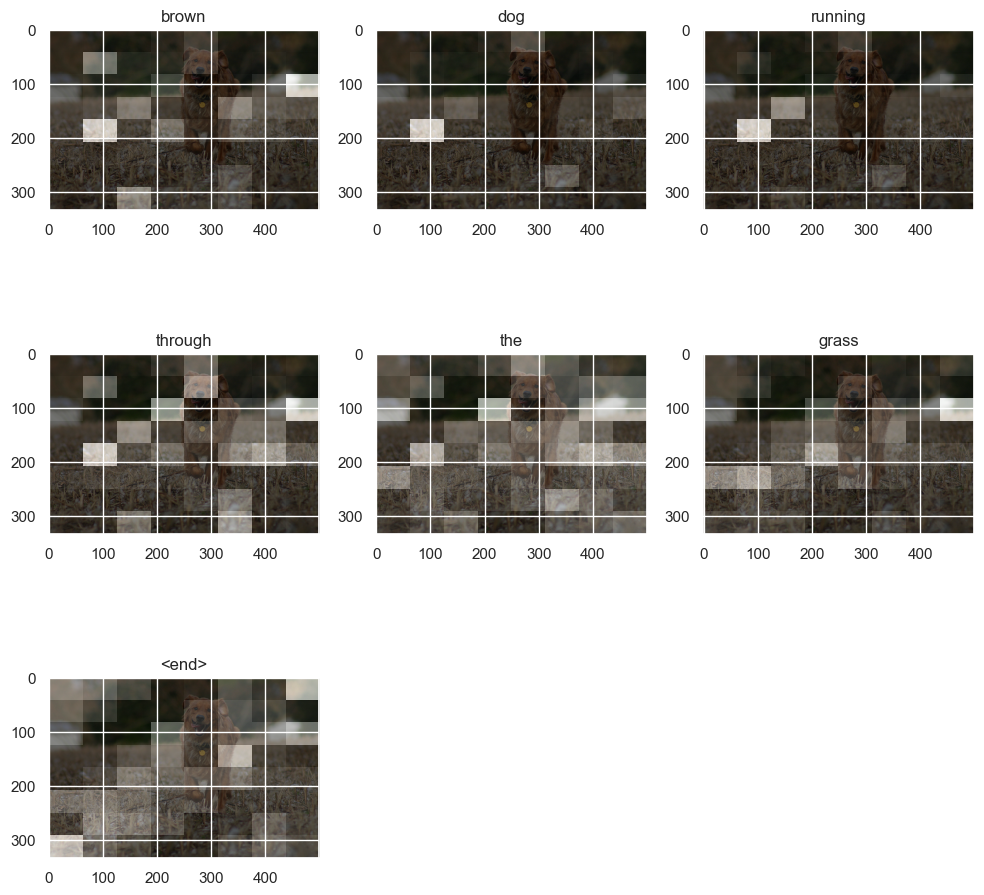

time took to Predict: 5 sec


FileNotFoundError: [Errno 2] No such file or directory: 'Flicker8k_Dataset/69189650_6687da7280.jpg'

In [201]:
# captions on the validation set

from PIL import Image

from nltk.translate.bleu_score import sentence_bleu

rid = np.random.randint(0, len(img_name_test))
image = 'C:/Users/Vipul gaikwad/Desktop/College/Sem 6/Image-Captioning-using-Attention-Mechanism-Local-Attention-and-Global-Attention--master/dataset/Flicker8k_Dataset/69189650_6687da7280.jpg'
print(image)
start = time.time()
real_caption = '<start> brown dog with his tongue <unk> as he runs through field <end>'
result, attention_plot = evaluate(image)
# result is in this format:  ['woman', 'plays', 'volleyball', '<end>']
# We need to remove <end> and join the list elements into a sentence. Also we need to remove <unk> from real_captions


first = real_caption.split(' ', 1)[1]
real_caption = first.rsplit(' ', 1)[0]

#remove "<unk>" in result
for i in result:
    if i=="<unk>":
        result.remove(i)


#remove <end> from result         
result_join = ' '.join(result)
result_final = result_join.rsplit(' ', 1)[0]

real_appn = []
real_appn.append(real_caption.split())
reference = real_appn
candidate = result_final.split()

score = sentence_bleu(reference, candidate, weights=(0.5, 0.5, 0, 0))
print(f"BELU score: {score*100}")

#print ('Real Caption:', real_caption)
print ('Prediction Caption(Beam=10):', result_final)

plot_attention(image, result, attention_plot)

print(f"time took to Predict: {round(time.time()-start)} sec")
# opening the image
Image.open('Flicker8k_Dataset/69189650_6687da7280.jpg')

## Conclusion:
- So all in all, I must say that my naive first-cut model, without any rigorous hyper-parameter tuning does a decent job in generating captions for images.
- We must understand that the images used for testing must be semantically related to those used for training the model. For example, if we train our model on the images of cats, dogs, etc. we must not test it on images of air planes, waterfalls, etc. This is an example where the distribution of the train and test sets will be very different and in such cases no Machine Learning model in the world will give good performance.
- Beam Search generated better results than Greedy Search.